In [1]:
import torch
import torch.nn as nn
from torch.utils import data
from torchvision.models import vgg19
from torchvision import transforms
from torchvision import datasets
import matplotlib.pyplot as plt
import numpy as np


/mnt/disk1/anaconda3/envs/phucnp/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import torch.nn as nn
from torch import einsum
import torch
from torchsummary import summary
from einops import rearrange

import sys
from model.backbone.efficient_net.model import EfficientNet

import re
import torch.nn.functional as F

import re, math
from model.vision_transformer.vit.vit import ViT, Transformer
from model.vision_transformer.vit.kvit import kNNTransformer
from model.vision_transformer.cnn_vit.efficient_vit import EfficientViT
from pytorchcv.model_provider import get_model

class CALayer(nn.Module):
    def __init__(self, channel, reduction=16, topk_rate=0.5):
        super(CALayer, self).__init__()
        # global average pooling: feature --> point
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        # feature channel downscale and upscale --> channel weight
        self.conv_du = nn.Sequential(
            nn.Conv2d(channel, channel // reduction, 1, padding=0, bias=True),
            nn.ReLU(inplace=True),
            nn.Conv2d(channel // reduction, channel, 1, padding=0, bias=True),
            nn.Sigmoid()
        )
        self.channel = channel
        self.topk_rate = topk_rate
        self.topk = int(channel * topk_rate)

    def forward(self, x):

        # x: B, C, W, H
        # y: B, C, 1, 1
        y = self.avg_pool(x)
        attn_weight = self.conv_du(y)   # B, C, 1, 1
        attn = attn_weight * x
        attnw_idx = torch.topk(input=attn_weight,k=self.topk,dim=1,largest=True, sorted=False).indices  # B, k, 1, 1
        attnw_idx = torch.sort(attnw_idx, dim=1).values
        attnw_idx = attnw_idx.expand(-1, -1, x.shape[2], x.shape[3])     
        attn = torch.gather(attn, dim=1, index=attnw_idx)
        return attn

class BasicConv(nn.Module):
    def __init__(self, in_planes, out_planes, kernel_size=3, stride=1, padding=1, dilation=1, groups=1, relu=True,
                 bn=True, bias=False):
        super(BasicConv, self).__init__()
        self.out_channels = out_planes
        self.conv = nn.Conv2d(in_planes, out_planes, kernel_size=kernel_size, stride=stride, padding=padding,
                              dilation=dilation, groups=groups, bias=bias)
        self.bn = nn.BatchNorm2d(out_planes, eps=1e-5, momentum=0.01, affine=True) if bn else None
        self.relu = nn.ReLU() if relu else None

    def forward(self, x):
        x = self.conv(x)
        if self.bn is not None:
            x = self.bn(x)
        if self.relu is not None:
            x = self.relu(x)
        return x

class ChannelPool(nn.Module):
    def forward(self, x):
        return torch.cat((torch.max(x, 1)[0].unsqueeze(1), torch.mean(x, 1).unsqueeze(1)), dim=1)

class spatial_attn_layer(nn.Module):
    def __init__(self, kernel_size=3):
        super(spatial_attn_layer, self).__init__()
        self.compress = ChannelPool()
        self.spatial = BasicConv(2, 1, kernel_size, stride=1, padding=(kernel_size - 1) // 2, relu=False)

    def forward(self, x):
        # import pdb;pdb.set_trace()
        x_compress = self.compress(x)
        x_out = self.spatial(x_compress)
        scale = torch.sigmoid(x_out)  # broadcasting
        return x * scale

class DAB(nn.Module):
    def __init__(self, n_feat: int, reduction: int, topk_rate=0.5, act_dab=None, dab_modules='sa-ca'):
        super(DAB, self).__init__()
        self.use_sa = True if 'sa' in dab_modules else False
        self.use_ca = True if 'ca' in dab_modules else False
        self.dab_modules = dab_modules
        self.SA = spatial_attn_layer() if self.use_sa else None             ## Spatial Attention
        self.CA = CALayer(n_feat, reduction, topk_rate)  if self.use_ca else None      ## Channel Attention
        self.conv1x1_1 = nn.Conv2d(n_feat * 2, n_feat, kernel_size=1)
        # self.conv1x1_2 = nn.Conv2d(n_feat, n_feat, kernel_size=1)
        self.conv1x1_3 = nn.Conv2d(int(n_feat * (1 + topk_rate)), n_feat, kernel_size=1)
        self.act = act_dab
        self.topk_rate = topk_rate

    def forward(self, ifreq, rgb):
        if self.use_sa:
            sa_branch = self.SA(ifreq)
        if self.use_ca:
            ca_branch = self.CA(ifreq)

        if self.use_sa and self.use_ca:
            attn = torch.cat([sa_branch, ca_branch], dim=1)
        if self.use_sa and not self.use_ca:
            attn = sa_branch
        if not self.use_sa and self.use_ca:
            attn = ca_branch

        # print(attn.shape)
        if '-' in self.dab_modules:
            attn = self.conv1x1_1(attn)

        # print("        attn shape: ", rgb.shape, attn.shape)
        res = torch.cat([rgb, attn], dim=1)
        res = self.conv1x1_3(res)
        if self.act:
            res = self.act(res)
        return res

class CrossAttention(nn.Module):
    def __init__(self, version='ca-fcat-0.5', in_dim=1024, activation=None, inner_dim=0, prj_out=False, qkv_embed=True):
        super().__init__()
        self.version = version
        self.use_freq = True if self.version.split('-')[1][0] == 'f' else False
        self.in_dim = in_dim
        self.qkv_embed = qkv_embed
        self.to_out = nn.Identity()
        self.activation = activation
        if self.qkv_embed:
            inner_dim = self.in_dim if inner_dim == 0 else inner_dim
            self.to_k = nn.Linear(in_dim, inner_dim, bias=False)
            self.to_v = nn.Linear(in_dim, inner_dim, bias = False)
            self.to_q = nn.Linear(in_dim, inner_dim, bias = False)
            self.to_out = nn.Sequential(
                nn.Linear(inner_dim, in_dim),
                nn.Dropout(p=0.1)
            ) if prj_out else nn.Identity()
        print("freq combine: ", self.use_freq)

    def forward(self, rgb, freq, ifreq):
        """
            x ~ rgb_vectors: (b, n, in_dim)
            y ~ freq_vectors: (b, n, in_dim)
            z ~ freq_vectors: (b, n, in_dim)
            Returns:
                attn_weight: (b, n, n)
                attn_output: (b, n, in_dim)
        """
        if self.qkv_embed:
            q = self.to_q(rgb)
            k = self.to_k(freq)
            v = self.to_v(ifreq)
        else:
            q, k, v = rgb, freq, ifreq
        attn_rgb_to_ifreq, attnweight_rgb_to_ifreq = self.scale_dot(q, k, v, dropout_p=0.00)
        if self.use_freq:
            attn_rgb_to_freq = torch.bmm(attnweight_rgb_to_ifreq, freq)
            attn_out = self.to_out(attn_rgb_to_freq)
        else:
            attn_out = self.to_out(attn_rgb_to_ifreq)
            
        fusion_out = self.fusion(rgb, attn_out)
        if self.activation is not None:
            fusion_out = self.activation(fusion_out)
        return fusion_out

    """
        Get from torch.nn.MultiheadAttention
        scale-dot: https://github.com/pytorch/pytorch/blob/1c5a8125798392f8d7c57e88735f43a14ae0beca/torch/nn/functional.py#L4966
        multi-head: https://github.com/pytorch/pytorch/blob/1c5a8125798392f8d7c57e88735f43a14ae0beca/torch/nn/functional.py#L5059
    """
    def scale_dot(self, q, k, v, attn_mask=None, dropout_p=0):
        B, Nt, E = q.shape
        q = q / math.sqrt(E)
        # (B, Nt, E) x (B, E, Ns) -> (B, Nt, Ns)
        attn = torch.bmm(q, k.transpose(-2, -1))
        if attn_mask is not None:
            attn += attn_mask
        attn = torch.nn.functional.softmax(attn, dim=-1)
        if dropout_p > 0.0:
            attn = torch.nn.functional.dropout(attn, p=dropout_p)
        # (B, Nt, Ns) x (B, Ns, E) -> (B, Nt, E)
        output = torch.bmm(attn, v)
        return output, attn

    def fusion(self, rgb, out_attn):
        """
        Arguments:
            rgb --      b, n, d
            out_attn -- b, n, d
        """
        weight = float(self.version.split('-')[-1])
        if 'cat' in self.version:
            out = torch.cat([rgb, weight * out_attn], dim=2)
        elif 'add' in self.version:
            out = torch.add(rgb, weight * out_attn)
        return out

class CMultiscaleViT(nn.Module):
    def __init__(self, in_channels=112, in_size=8, patch_reso='1-2-4-8', gamma_reso='0.8_0.4_0.2_0.1', residual=True,\
                qkv_embed=True, prj_out=True, activation=None, fusca_version='ca-fcat-0.5', \
                useKNN=True, depth=6, heads=8, dim=1024, mlp_dim=2048, dim_head=64, dropout=0.15, share_weight=True):
        super(CMultiscaleViT, self).__init__()
        self.dim = dim
        self.depth = depth
        self.heads = heads
        self.dim_head = dim_head
        self.mlp_dim = mlp_dim
        self.dropout_value = dropout

        self.fusca_version = fusca_version
        self.residual = residual
        self.patch_reso = patch_reso
        self.gamma_reso = gamma_reso

        self.patch_size = list(map(int, patch_reso.split('-')))
        self.gamma_reso = list(map(float, gamma_reso.split('_')))
        self.gamma = []
        self.g0 = nn.Parameter(torch.ones(1))
        self.g1 = nn.Parameter(torch.ones(1))
        self.g2 = nn.Parameter(torch.ones(1))
        self.g3 = nn.Parameter(torch.ones(1))
        cnt = 0
        if residual:
            for g in self.gamma_reso:
                if g != 0:
                    self.gamma.append(g)
                else:
                    if cnt == 0:
                        self.gamma.append(self.g0)
                    if cnt == 1:
                        self.gamma.append(self.g1)
                    if cnt == 2:
                        self.gamma.append(self.g2)
                    if cnt == 3:
                        self.gamma.append(self.g3)
                    cnt += 1

        self.num_patches = [int((in_size // p)** 2) for p in self.patch_size]
        self.n_chunks = len(self.patch_size)
        with torch.no_grad():
            test_inp = torch.ones(4, in_channels, in_size, in_size)
            test_chunks = torch.chunk(test_inp, chunks=self.n_chunks, dim=1)
            self.chunk_channels = [chunk.shape[1] for chunk in test_chunks]
        self.patch_dim = [int(self.chunk_channels[i] * (self.patch_size[i] ** 2)) for i in range(self.n_chunks)]


        ############################# CROSS ATTENTION #############################
        self.cross_attention = nn.ModuleList([])
        for p_dim in self.patch_dim:
            self.cross_attention.append(CrossAttention(version=fusca_version, in_dim=p_dim, activation=activation, inner_dim=0, prj_out=prj_out, qkv_embed=qkv_embed))

        ############################# VIT #########################################
        # Giảm chiều vector sau concat 2*patch_dim về D:
        self.embedding = nn.ModuleList([])
        for p_dim in self.patch_dim:
            if 'cat' in self.fusca_version:
                self.embedding.append(nn.Linear(2 * p_dim, self.dim))
            else:
                self.embedding.append(nn.Linear(p_dim, self.dim))
        # transformer:
        self.share_weight = share_weight
        if not share_weight:
            self.transformers = nn.ModuleList([])
            for _ in range(len(self.patch_size)):
                if useKNN == 0:
                    print("use vanilla attention")
                    self.transformers.append(Transformer(self.dim, self.depth, self.heads, self.dim_head, self.mlp_dim, self.dropout_value))
                elif useKNN > 0:
                    print("use KNN attention: topK ratio: ", useKNN)
                    self.transformers.append(kNNTransformer(self.dim, self.depth, self.heads, self.mlp_dim, self.dropout_value, useKNN))
                else:
                    print("error when use attention...")
        else:
            if useKNN == 0:
                print("use vanilla attention")
                self.transformer = Transformer(self.dim, self.depth, self.heads, self.dim_head, self.mlp_dim, self.dropout_value)
            elif useKNN > 0:
                print("use KNN attention: topK ratio: ", useKNN)
                self.transformer = kNNTransformer(self.dim, self.depth, self.heads, self.mlp_dim, self.dropout_value, useKNN)
            else:
                print("error when use attention...")
        
    def forward(self, rgb_features, freq_features, ifreq_features):
        outputs = []
        rgbs = torch.chunk(rgb_features, self.n_chunks, dim=1)
        freqs = torch.chunk(freq_features, self.n_chunks, dim=1)
        ifreqs = torch.chunk(ifreq_features, self.n_chunks, dim=1)

        for i in range(self.n_chunks):
            # Flatten to vectors:
            # print("shape: ", rgbs[i].shape, " ", freqs[i].shape, " ", ifreqs[i].shape)
            rgb_vectors = self.flatten_to_vectors(feature=rgbs[i], p_size=self.patch_size[i])      # B, num_patch, patch_dim
            freq_vectors = self.flatten_to_vectors(feature=freqs[i], p_size=self.patch_size[i])    # B, num_patch, patch_dim
            ifreq_vectors = self.flatten_to_vectors(feature=ifreqs[i], p_size=self.patch_size[i])  # B, num_patch, patch_dim
            # print("patchsize: ", self.patch_size[i])
            # print("     Vectors shape: ", rgb_vectors.shape, freq_vectors.shape, ifreq_vectors.shape)

            # Cross attention:
            attn_out = self.cross_attention[i](rgb_vectors, freq_vectors, ifreq_vectors)    # B, num_patch, patch_dim/2*patch_dim
            # print("     attn out shape: ", attn_out.shape)

            # ViT:
            embed = self.embedding[i](attn_out)                # B, num_patch, dim
            if not self.share_weight:       
                output = self.transformers[i](embed)                # B, num_patch, dim
            else:
                output = self.transformer(embed)
            if self.residual:
                output = embed + self.gamma[i] * output        # B, num_patch, dim
            # print("     output shape: ", output.shape)
            output = output.mean(dim = 1).squeeze(dim=1)          # B, 1, dim
            outputs.append(output)
        
        out = torch.cat(outputs, dim=1)
        # print("multi shape: ", out.shape)
        return out

    def flatten_to_vectors(self, feature=None, p_size=1):
        return rearrange(feature, 'b c (h p1) (w p2) -> b (h w) (p1 p2 c)', p1=p_size, p2=p_size)
  
class PairwiseDualDabCNNCMultiViT2(nn.Module):
    def __init__(self, image_size=224, num_classes=1, \
                dim=1024, depth=6, heads=8, mlp_dim=2048, dim_head=64, dropout=0.15,\
                backbone='xception_net', pretrained=True,unfreeze_blocks=-1,\
                normalize_ifft='batchnorm',\
                qkv_embed=True, prj_out=False, act='none',\
                patch_reso='1-2-4-8', gammaagg_reso='0.8_0.4_0.2_0.1',\
                fusca_version='ca-fcat-0.5',\
                features_at_block='10', \
                dropout_in_mlp=0.0, residual=True, transformer_shareweight=True, \
                act_dab='none', topk_channels=0.5, dab_modules='sa-ca', dabifft_normalize='none', dab_blocks='1_3_6_9', \
                embedding_return='mlp_hidden', useKNN=0):  

        super(PairwiseDualDabCNNCMultiViT2, self).__init__()

        self.image_size = image_size
        self.num_classes = num_classes
        self.backbone = backbone
        if 'efficient_net' in backbone:
            dab_blocks = '-1_' + dab_blocks
        self.dab_blocks = sorted(list(map(int, dab_blocks.split('_'))))
        print("dab blocks: ", self.dab_blocks)
        self.dabifft_normalize = dabifft_normalize
        self.last_block = int(features_at_block) if features_at_block != 'final' else 15

        self.features_size = {
            'efficient_net': {
                '0': (16, 64, 64),
                '1': (24, 32, 32),
                '2': (24, 32, 32),
                '3': (40, 16, 16),
                '4': (40, 16, 16),
                '5': (80, 8, 8),
                '6': (80, 8, 8),
                '7': (80, 8, 8),
                '8': (112, 8, 8),
                '9': (112, 8, 8),
                '10': (112, 8, 8),
                '11': (192, 4, 4),
                '12': (192, 4, 4),
                '13': (192, 4, 4),
                '14': (192, 4, 4),
                '15': (320, 4, 4),
                'final': (1280, 4, 4)
            },
            'xception_net': {
                'final': (2048, 4, 4)
            }
        }
        self.out_ext_channels = self.features_size[backbone][features_at_block][0]
        self.out_ext_size = self.features_size[backbone][features_at_block][1]
        self.fusca_version = fusca_version  # in ['ca-rgb_cat-0.5', 'ca-freq_cat-0.5']
        self.activation = self.get_activation(act)
        self.dab_activation = self.get_activation(act_dab)

        self.pretrained = pretrained
        self.features_at_block = features_at_block
        self.rgb_extractor = self.get_feature_extractor(architecture=backbone, pretrained=pretrained, unfreeze_blocks=unfreeze_blocks, num_classes=num_classes, in_channels=3)   # efficient_net-b0, return shape (1280, 8, 8) or (1280, 7, 7)
        self.freq_extractor = self.get_feature_extractor(architecture=backbone, pretrained=pretrained, unfreeze_blocks=unfreeze_blocks, num_classes=num_classes, in_channels=1)     
        self.normalize_ifft = normalize_ifft
        if self.normalize_ifft == 'batchnorm':
            self.batchnorm_ifft = nn.BatchNorm2d(num_features=self.out_ext_channels)
        if self.normalize_ifft == 'layernorm':
            self.layernorm_ifft = nn.LayerNorm(normalized_shape=self.features_size[backbone][features_at_block])
        
        # DAB Block:
        num_dab = len(self.dab_blocks) - 1
        self.dab = nn.ModuleList([])
        for i in range(num_dab):
            at_block = self.dab_blocks[i+1]
            in_features = self.features_size[backbone][str(at_block)][0]
            self.dab.append(DAB(n_feat=in_features, reduction=1, topk_rate=topk_channels, act_dab=self.dab_activation, dab_modules=dab_modules))

        # Multi ViT:
        self.multi_transformer = CMultiscaleViT(in_channels=self.out_ext_channels, in_size=self.out_ext_size, patch_reso=patch_reso, gamma_reso=gammaagg_reso,\
                                          qkv_embed=qkv_embed, prj_out=prj_out, activation=self.activation, fusca_version=fusca_version,\
                                          useKNN=useKNN, depth=depth, heads=heads, dim=dim, mlp_dim=mlp_dim, dim_head=dim_head, dropout=dropout, residual=residual, share_weight=transformer_shareweight)

        self.mlp_relu = nn.ReLU(inplace=True)
        self.mlp_head_hidden = nn.Linear(len(patch_reso.split('-')) * dim, mlp_dim)
        self.mlp_dropout = nn.Dropout(dropout_in_mlp)
        self.mlp_head_out = nn.Linear(mlp_dim, self.num_classes)
        #
        self.embedding_return = embedding_return

    def get_activation(self, act):
        if act == 'relu':
            activation = nn.ReLU(inplace=True)
        elif act == 'tanh':
            activation = nn.Tanh()
        elif act == 'sigmoid':
            activation = nn.Sigmoid()
        elif act == 'leakyrely':
            activation = nn.LeakyReLU()
        elif act == 'selu':
            activation = nn.SELU()
        elif act == 'gelu':
            activation = nn.GELU()
        else:
            activation = None
        return activation

    def get_feature_extractor(self, architecture="efficient_net", unfreeze_blocks=-1, pretrained=False, num_classes=1, in_channels=3):
        extractor = None
        if architecture == "efficient_net":
            extractor = EfficientNet.from_pretrained('efficientnet-b0', num_classes=num_classes,in_channels = in_channels, pretrained=bool(pretrained))
            if unfreeze_blocks != -1:
                # Freeze the first (num_blocks - 3) blocks and unfreeze the rest 
                for i in range(0, len(extractor._blocks)):
                    for index, param in enumerate(extractor._blocks[i].parameters()):
                        if i >= len(extractor._blocks) - unfreeze_blocks:
                            param.requires_grad = True
                        else:
                            param.requires_grad = False
        
        if architecture == 'xception_net':
            xception = get_model("xception", pretrained=bool(pretrained))
            extractor = nn.Sequential(*list(xception.children())[:-1])
            extractor[0].final_block.pool = nn.Identity()
            if in_channels != 3:
                extractor[0].init_block.conv1.conv = nn.Conv2d(1, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)

            if unfreeze_blocks != -1:
                blocks = len(extractor[0].children())
                print("Number of blocks in xception: ", len(blocks))
                for i, block in enumerate(extractor[0].children()):
                    if i >= blocks - unfreeze_blocks:
                        for param in block.parameters():
                            param.requires_grad = True
                    else:
                        for param in block.parameters():
                            param.requires_grad = False
        print("Pretrained backbone: ", bool(pretrained))
        return extractor

    def ifft(self, freq_feature, norm_type='none'):
        ifreq_feature = torch.log(torch.abs(torch.fft.ifft2(torch.fft.ifftshift(freq_feature))) + 1e-10)  # Hơi ảo???
        if norm_type == 'none':
            pass
        elif norm_type == 'batchnorm':
            ifreq_feature = self.batchnorm_ifft(ifreq_feature)
        elif norm_type == 'layernorm':
            ifreq_feature = self.layernorm_ifft(ifreq_feature)
        elif norm_type == 'normal':
            ifreq_feature = F.normalize(ifreq_feature)
        elif norm_type == 'no_ifft':
            return freq_feature
        return ifreq_feature

    def extract_feature(self, rgb_imgs, freq_imgs, img0=True):
        if self.backbone == 'efficient_net':
            # Conv stem:
            temp_features = None
            rgb_features = self.rgb_extractor.extract_features_convstem(rgb_imgs)                 
            freq_features = self.freq_extractor.extract_features_convstem(freq_imgs)
            
            # print("Features shape: ", rgb_features.shape)
            # DAB Block:
            for i in range(len(self.dab_blocks) - 1):   # -1_1_3_6_9
                                                        #  0 1 2 3 4
                # print("dab_blocks: ", self.dab_blocks[i]+1, ' -> ', self.dab_blocks[i+1])
                rgb_features = self.rgb_extractor.extract_features_block_inrange(rgb_features, from_block=self.dab_blocks[i]+1, to_block=self.dab_blocks[i+1])
                freq_features = self.freq_extractor.extract_features_block_inrange(freq_features, from_block=self.dab_blocks[i]+1, to_block=self.dab_blocks[i+1])

                if i == 0 and img0:
                    temp_features = rgb_features
                    h = rgb_features.register_hook(self.activations_hook)
                # Attention, concat and reduce channels:
                ifreq_features = self.ifft(freq_features, norm_type=self.dabifft_normalize)
                # print(" Shape: ", rgb_features.shape, ifreq_features.shape)
                rgb_features = self.dab[i](ifreq_features, rgb_features)

            # Last block:
            rgb_features = self.rgb_extractor.extract_features_block_inrange(rgb_features, from_block=self.dab_blocks[-1]+1, to_block=self.last_block)
            freq_features = self.freq_extractor.extract_features_block_inrange(freq_features, from_block=self.dab_blocks[-1]+1, to_block=self.last_block)
            
            # Convhead:
            # print("After last block Features shape: ", rgb_features.shape, freq_features.shape)
            if self.features_at_block == 'final':
                rgb_features = self.rgb_extractor.extract_features_convhead(rgb_features)
                freq_features = self.freq_extractor.extract_features_convhead(freq_features)
        else:
            rgb_features = self.rgb_extractor(rgb_imgs)
            freq_features = self.freq_extractor(freq_imgs)

        # if img0:
        return rgb_features, freq_features, temp_features
        # return rgb_features, freq_features

    # hook for the gradients of the activations
    def activations_hook(self, grad):
        self.gradients = grad
        
    # method for the gradient extraction
    def get_activations_gradient(self):
        return self.gradients
    
    # method for the activation exctraction
    def get_activations(self, rgb, freq):
        return self.extract_feature(rgb, freq, True)[-1]

    def forward_once(self, rgb_imgs, freq_imgs, img0=True):
        # rgb_features, freq_features, _ = self.extract_feature(rgb_imgs, freq_imgs, img0)
        rgb_features, freq_features, _ = self.extract_feature(rgb_imgs, freq_imgs, img0)
        # if img0:
        #     rgb_features.register_hook(self.activations_hook)

        #
        ifreq_features = self.ifft(freq_features, norm_type=self.normalize_ifft)
        # print("Features shape: ", rgb_features.shape, freq_features.shape, ifreq_features.shape)

        ##### Forward to ViT
        e1 = self.multi_transformer(rgb_features, freq_features, ifreq_features)     # B, number_of_patch * D

        x = self.mlp_dropout(e1)         # B, number_of_patch * D
        e2 = self.mlp_head_hidden(x)     # B, number_of_patch * D => B, mlp_dim
        x = self.mlp_relu(e2)
        x = self.mlp_dropout(x)
        e3 = self.mlp_head_out(x)        # B, mlp_dim => B, 1
        e = None
        if self.embedding_return=='mlp_before':
            e = e1
        if self.embedding_return=='mlp_hidden':
            e = e2
        if self.embedding_return=='mlp_out':
            e = e3
        return e, e3

    def forward(self, rgb_imgs0, freq_imgs0, rgb_imgs1, freq_imgs1):
        embedding_0, out_0 = self.forward_once(rgb_imgs0, freq_imgs0, True)
        embedding_1, out_1 = self.forward_once(rgb_imgs1, freq_imgs1, False)
        # print("embed: ", embedding_0.shape, "   out: ", out_0.shape)
        return embedding_0, out_0, embedding_1, out_1

import os
os.environ['CUDA_VISIBLE_DEVICES'] = '3'
device = torch.device('cuda')
checkpoints = {
    'deepfake': "/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/x2face/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04598_0.9998_1.0000_1.0000)_fold_0/step/best_test_acc_400_1.000000.pt",
    '3dmm': '/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/3dmm/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04585_1.0000_0.9999_1.0000)_fold_0/step/best_test_acc_600_1.000000.pt',
    'x2face': '/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/x2face/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04598_0.9998_1.0000_1.0000)_fold_0/step/best_test_acc_400_1.000000.pt',
    'faceswap_2d': '/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/faceswap_2d/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04362_0.9994_0.9989_0.9996)_fold_0/step/best_test_acc_8300_0.999600.pt',
    'faceswap_3d': '/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/faceswap_3d/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04369_0.9995_0.9987_1.0000)_fold_3/step/best_test_acc_8200_1.000000.pt',
    'monkey': "/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/monkey/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0.2_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04306_0.9990_0.9988_0.9994)_fold_4/step/best_test_acc_9000_0.999400.pt",
    "reenact": "/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/reenact/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0.2_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04493_1.0000_1.0000_1.0000)_fold_0/step/best_test_acc_200_1.000000.pt",
    "stargan": "/mnt/disk1/doan/phucnp/Graduation_Thesis/my_thesis/forensics/dl_technique/checkpoint/visualization/stargan/kfold_pairwise_dual_dab_cnn_multivit_twooutput/lr0.0002-0_b32_c1_esnone_lbce_nf5trick0_retmlp_hidden_im1.0mar0.4_vca-ifadd-0.8_KNN0_d512md1024h4d3_bbefficient_netpre1_fatb11_pres1-2-4_res1_gres0.2_0.2_0.2_sh0_nrmbatchnorm_qkv1_prj1_actselunone_topk0.35_dabmca_dabinone_dabb8_9_10_sd0_dr0.3aug0/(0.04364_0.9997_0.9998_1.0000)_fold_0/step/best_test_acc_2000_1.000000.pt"
}
technique = 'faceswap_2d'

model = PairwiseDualDabCNNCMultiViT2(image_size=128, num_classes=2, \
                dim=512, depth=3, heads=4, mlp_dim=1024, dim_head=64, dropout=0.0,\
                backbone='efficient_net', pretrained=True,unfreeze_blocks=-1,\
                normalize_ifft='batchnorm',\
                qkv_embed=True, prj_out=True, act='selu',\
                patch_reso='1-2-4', gammaagg_reso='0.2_0.2_0' if not '0.2_0.2_0.2' in checkpoints[technique] else '0.2_0.2_0.2',\
                fusca_version='ca-ifadd-0.8',\
                features_at_block='11', \
                dropout_in_mlp=0.3, residual=True, transformer_shareweight=False, \
                act_dab='none', topk_channels=0.35, dab_modules='ca', dabifft_normalize='none', dab_blocks='8_9_10', \
                embedding_return='mlp_hidden', useKNN=0)

model.load_state_dict(torch.load(checkpoints[technique]))
model = model.to(device)

dab blocks:  [-1, 8, 9, 10]
Loaded pretrained weights for efficientnet-b0
Pretrained backbone:  True
Loaded pretrained weights for efficientnet-b0
Pretrained backbone:  True
freq combine:  False
freq combine:  False
freq combine:  False
use vanilla attention
use vanilla attention
use vanilla attention


In [3]:
import glob
from torch.utils.data import Dataset
from PIL import Image, ImageEnhance
import copy
import random
import cv2

class PairwiseDualFFTMagnitudeImageDataset(Dataset):
    def __init__(self, path=None, image_size=128, transform=None, transform_fft=None, should_invert=True,shuffle=True, adj_brightness=None, adj_contrast=None, dset=None, usephase=False):
        self.path = path
        # self.imageFolderDataset = ImageFolder(path)
        self.image_size = image_size
        self.transform = transform
        self.transform_fft = transform_fft
        self.should_invert = should_invert
        self.shuffle = shuffle
        self.adj_brightness = adj_brightness
        self.adj_contrast = adj_contrast
        data_path = []
        if dset is None:
            data_path = data_path + glob.glob(path + "/*/*.jpg")
            data_path = data_path + glob.glob(path + "/*/*.jpeg")
            data_path = data_path + glob.glob(path + "/*/*.png")
        else:
            data_path = copy.deepcopy(dset)
        self.data_path = data_path
        self.usephase = usephase
        np.random.shuffle(self.data_path)
        self.indexes = range(len(self.data_path))
        self.on_epoch_end()

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        if self.shuffle == True:
            np.random.shuffle(self.data_path)

    def find_label(self, img_path):
        y = 0
        if '0_real' in img_path:
            y = 0
        elif '1_df' in img_path or '1_f2f' in img_path or '1_fs' in img_path or '1_nt' in img_path or '1_fake' in img_path:
            y = 1
        return y

    def __getitem__(self, index):
        img0_path = self.data_path[index]
        #we need to make sure approx 50% of images are in the same class
        img0_label = self.find_label(img0_path)
        should_get_same_class = random.randint(0,1) 
        if should_get_same_class:
            while True:
                #keep looping till the same class image is found
                img1_index = random.choice(self.indexes)
                if index == img1_index:
                    continue
                img1_path = self.data_path[img1_index]
                img1_label = self.find_label(img1_path)
                if img0_label == img1_label:
                    break
        else:
            while True:
                #keep looping till the same class image is found
                img1_index = random.choice(self.indexes)
                if index == img1_index:
                    continue
                img1_path = self.data_path[img1_index]
                img1_label = self.find_label(img1_path)
                if img0_label != img1_label:
                    break

        PIL_img0, PIL_img1, fft_img0, fft_img1 = self.__data_generation(img0_path, img1_path)
        # print(img0_path, img1_path)
        # print(img0_label, img1_label)

        if img0_label != img1_label:
            label_contrastive = 1
        else:
            label_contrastive = 0
        return PIL_img0, fft_img0, img0_label, PIL_img1, fft_img1, img1_label, label_contrastive, img0_path

    def __data_generation(self, img0_path, img1_path):
        PIL_img0, fft_img0 = self.__get_dual_images(img0_path)
        PIL_img1, fft_img1 = self.__get_dual_images(img1_path)
        return PIL_img0, PIL_img1, fft_img0, fft_img1


    def __get_dual_images(self, img_path):
       # Read image in RGB and resize to (image_size, image_size)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
        img = cv2.resize(img,(self.image_size,self.image_size))
        
        # Adjust brightness and contrast if have corresponding parameters
        if self.adj_brightness is not None and self.adj_contrast is not None:
            PIL_img1 = Image.fromarray(img)
            enhancer = ImageEnhance.Brightness(PIL_img1)
            img_adj = enhancer.enhance(self.adj_brightness)
            enhancer = ImageEnhance.Contrast(img_adj)
            img_adj = enhancer.enhance(self.adj_contrast)
            img = np.array(img_adj)

        # Convert to PIL Image instance and transform spatial image
        PIL_img = Image.fromarray(img)
        if self.transform is not None:
            PIL_img = self.transform(PIL_img)
            
        ############ Make FFT image ############
        # Make another instance of image to do fourier transform
        img2 = transforms.ToPILImage()(PIL_img)
        img2 = np.array(img2)
        # 2D-Fourier transform, needs convert to gray-scale image to do transform
        f = np.fft.fft2(cv2.cvtColor(img2,cv2.COLOR_RGB2GRAY))
        # Shift by spectral image
        fshift = np.fft.fftshift(f)
        fshift += 1e-8
        # Generate magnitude spectrum image
        magnitude_spectrum = np.log(np.abs(fshift))
        if self.usephase:
            magnitude_spectrum = np.angle(fshift)
        magnitude_spectrum = cv2.resize(magnitude_spectrum, (self.image_size,self.image_size))
        magnitude_spectrum = np.array([magnitude_spectrum])
        magnitude_spectrum = np.transpose(magnitude_spectrum, (1, 2, 0))    # From C, H, W =>  H, W, C
        
        if self.transform_fft is not None:
            magnitude_spectrum = self.transform_fft(magnitude_spectrum)
        return PIL_img, magnitude_spectrum

    def __len__(self):
        return int(np.floor(len(self.data_path)))

def generate_test_dataloader_dual_cnn_stream_for_kfold_pairwise(test_dir, image_size, batch_size, num_workers, usephase=False):
    transform_test_fwd = transforms.Compose([transforms.Resize((image_size,image_size)),\
                                            transforms.ToTensor(), \
                                            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                                            ])
    transform_fft = transforms.Compose([transforms.ToTensor()])                
    test_pairwise_dualfft_dataset = PairwiseDualFFTMagnitudeImageDataset(path=test_dir, image_size=image_size, transform=transform_test_fwd, transform_fft=transform_fft, usephase=usephase)
    test_dataloader  = torch.utils.data.DataLoader(test_pairwise_dualfft_dataset, batch_size=batch_size, num_workers=num_workers, shuffle=False)
    assert test_pairwise_dualfft_dataset, "Val dataset is None!"
    return test_dataloader

Test dir:  /mnt/disk1/doan/phucnp/Dataset/my_extend_data/extend_data_train/faceswap_2d/test
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.9124,  -5.5329]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])


[W Copy.cpp:219] Warning: Casting complex values to real discards the imaginary part (function operator())


activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

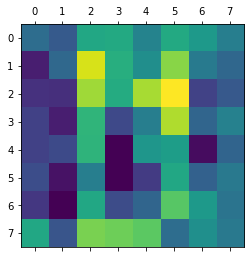

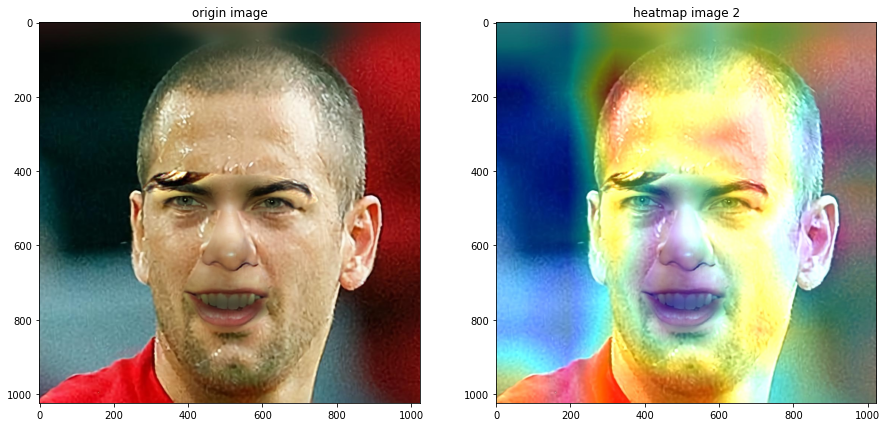

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-24.1683,  -2.0704]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

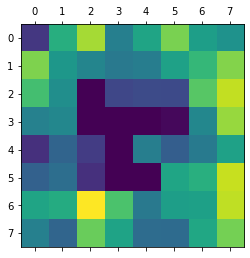

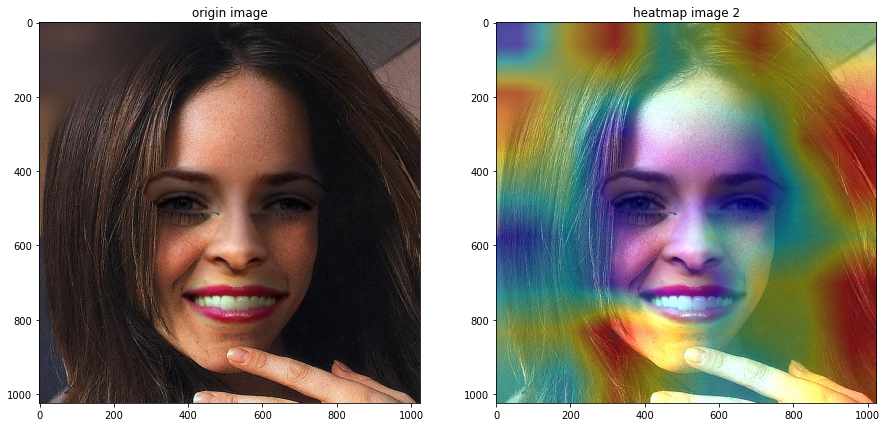

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.3892,  -5.4041]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

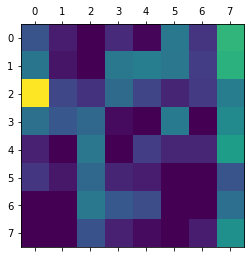

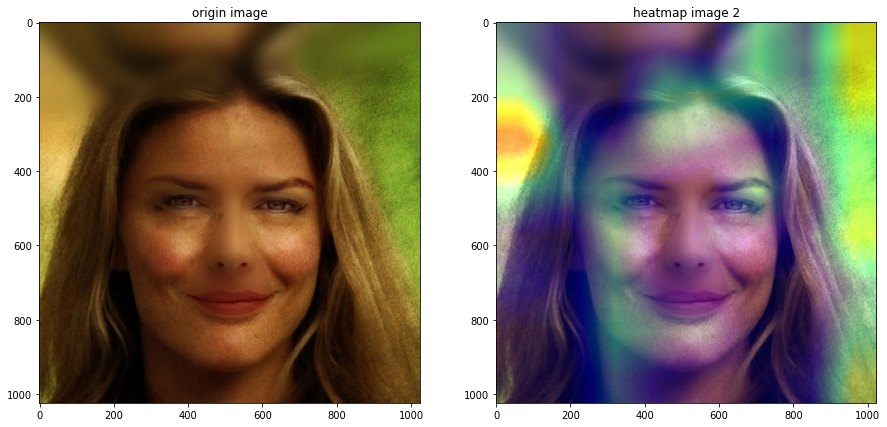

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -1.3710, -24.7244]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.3797, -24.0239]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.5147, -25.3081]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.6524, -21.4547]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.4940, -25.8893]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.9102, -24.8649]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.9671, -24.7044]], device='cud

<Figure size 1440x1440 with 0 Axes>

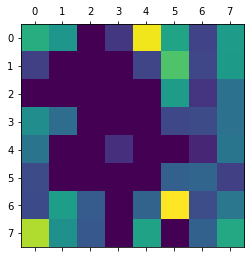

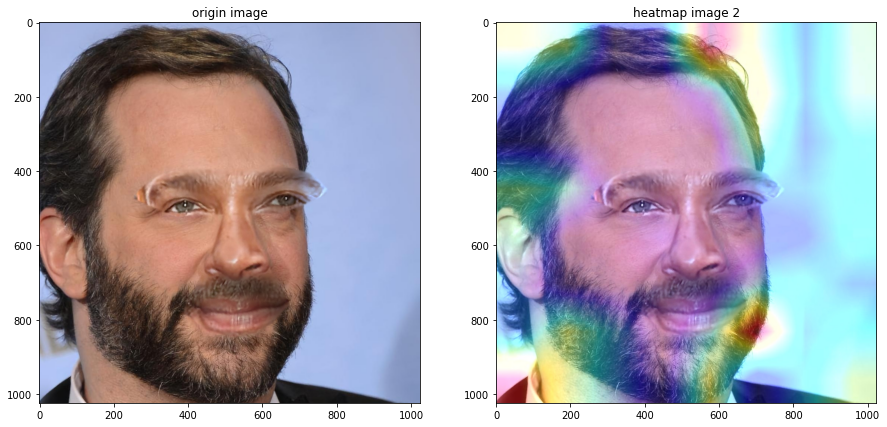

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-20.5376,  -2.3330]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

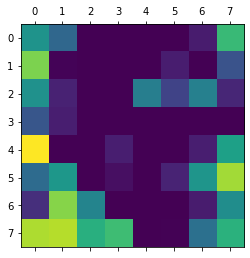

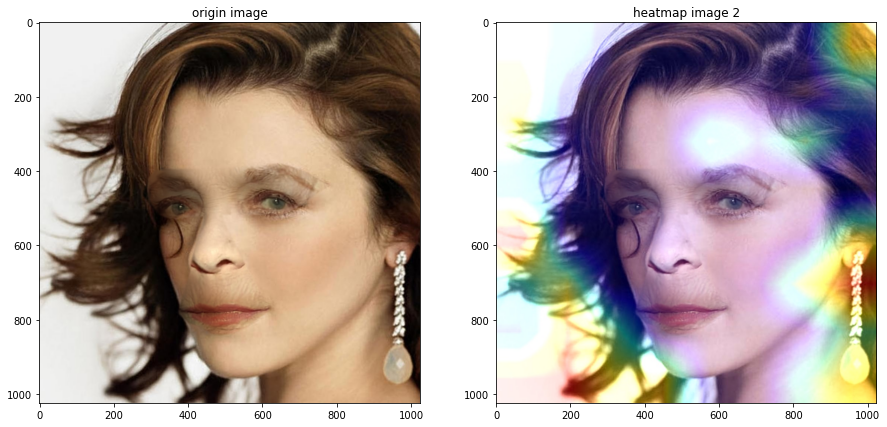

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.0523,  -4.4334]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

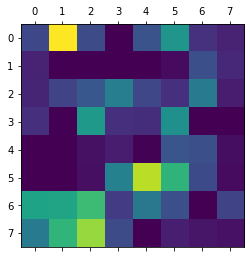

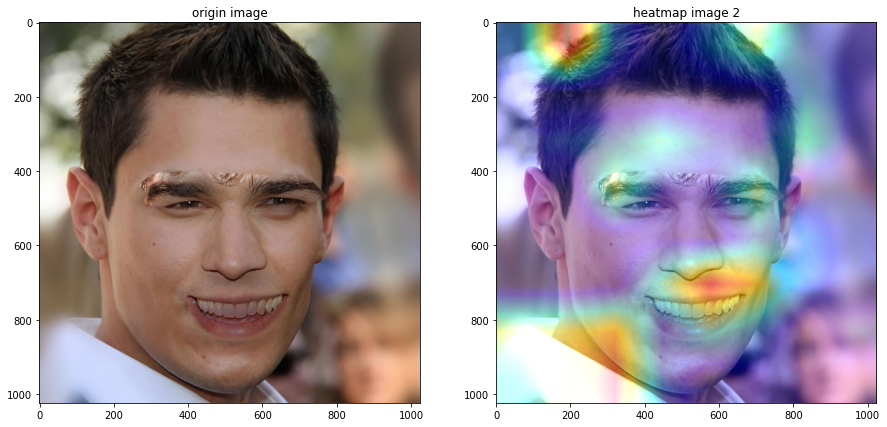

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.1576, -25.2008]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.3217,  -6.7659]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

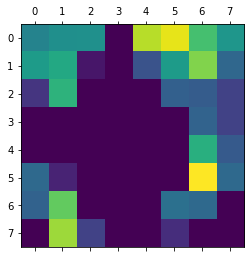

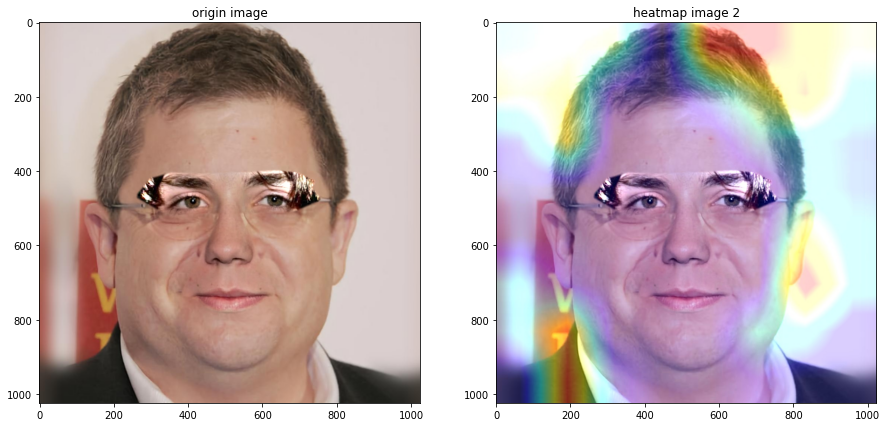

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.5857, -23.2729]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.0904, -25.3069]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.8397,  -4.3304]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

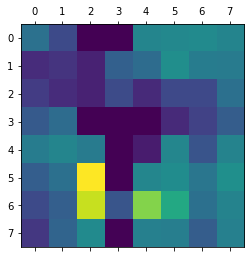

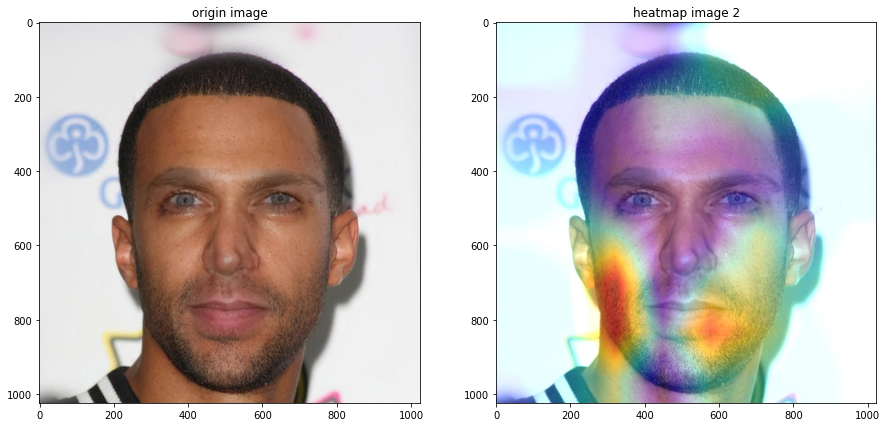

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.9429,  -4.1764]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

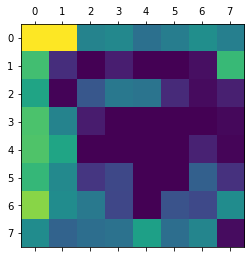

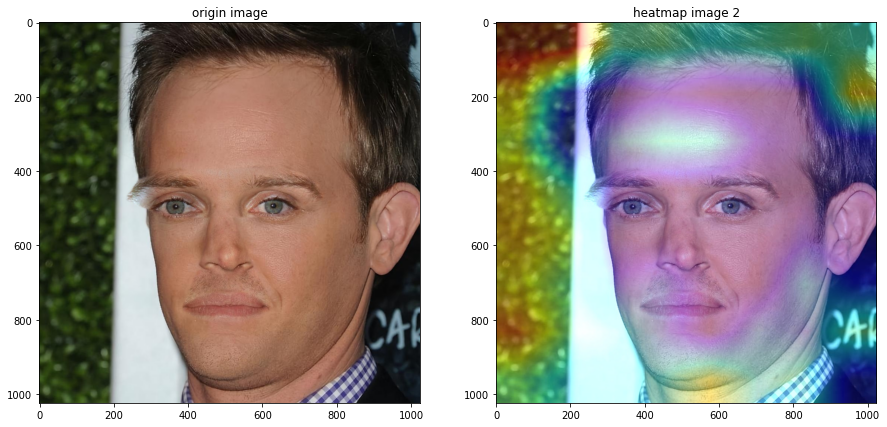

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.1541, -24.4714]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.4032,  -2.9701]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

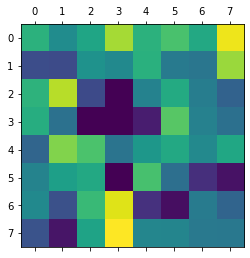

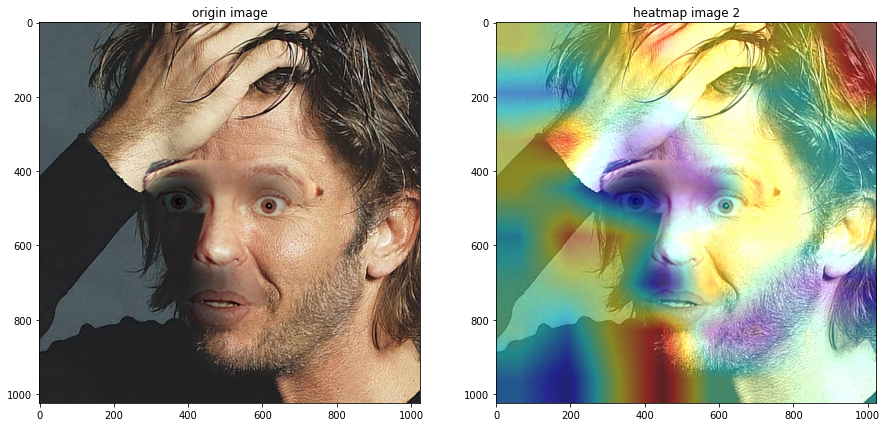

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-20.8690,  -5.9741]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

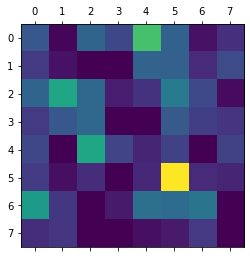

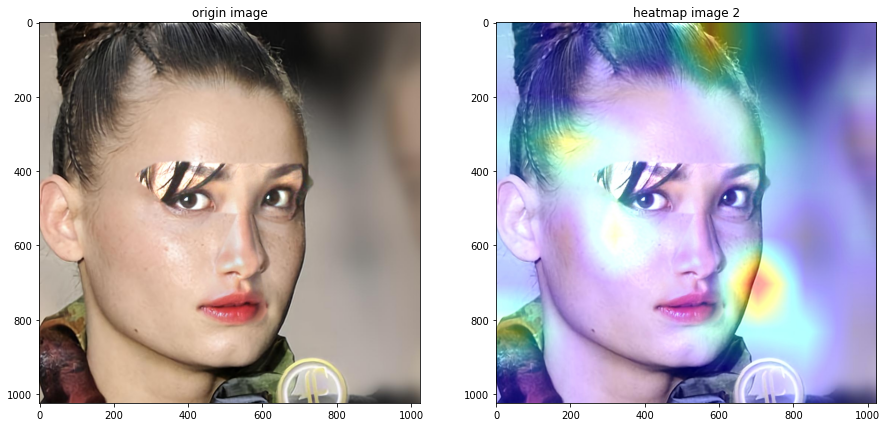

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.5425, -27.6173]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.7881,  -4.4069]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

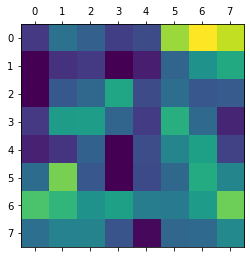

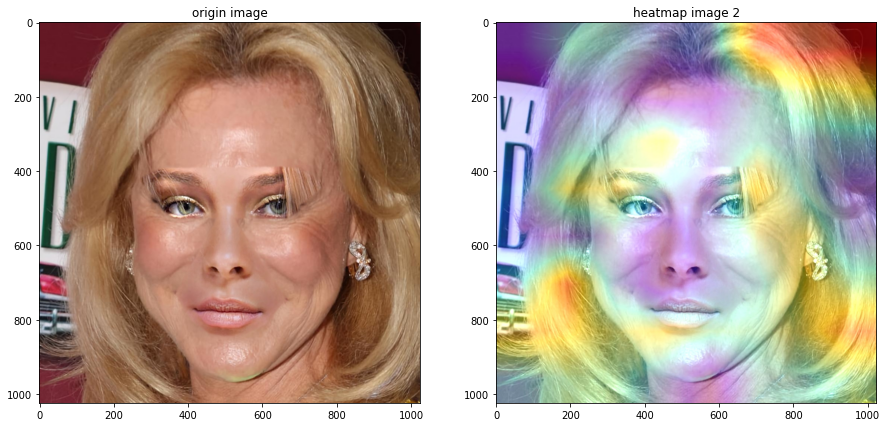

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-21.0682,  -5.0717]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

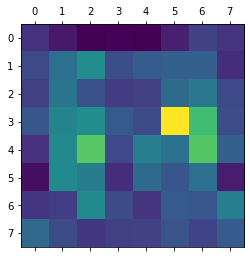

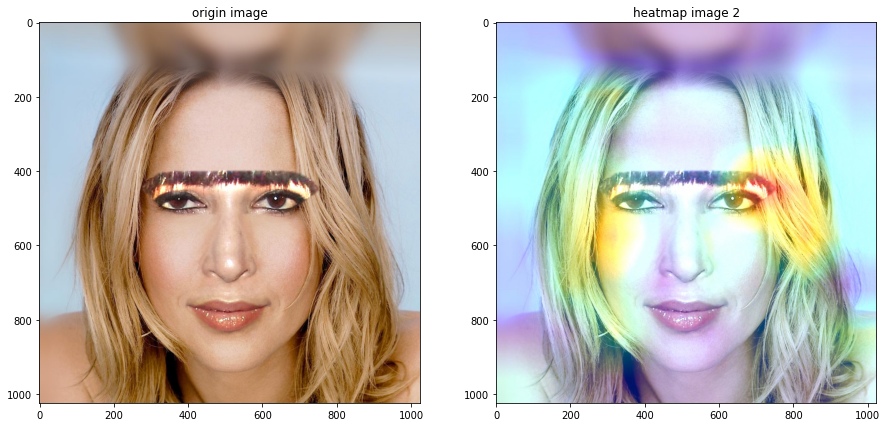

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.2682, -22.7985]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.3916, -23.9725]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -2.2456, -19.4128]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.5548, -25.5618]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  3.3340, -27.3574]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.8661, -24.7752]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.5973, -24.0598]], device='cud

<Figure size 1440x1440 with 0 Axes>

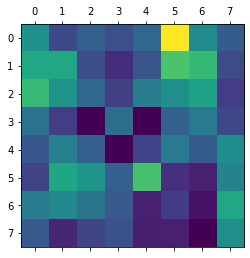

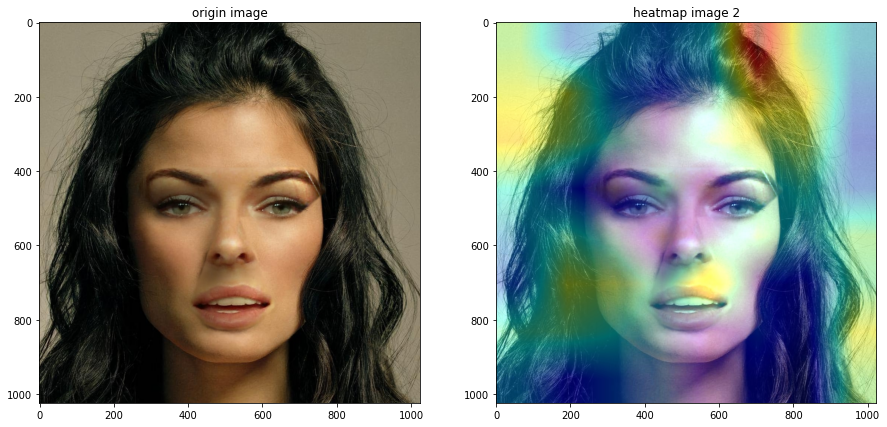

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  2.2056, -24.6814]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.5031, -24.6222]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-21.7525,  -4.4696]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

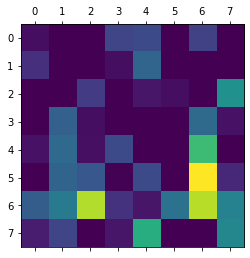

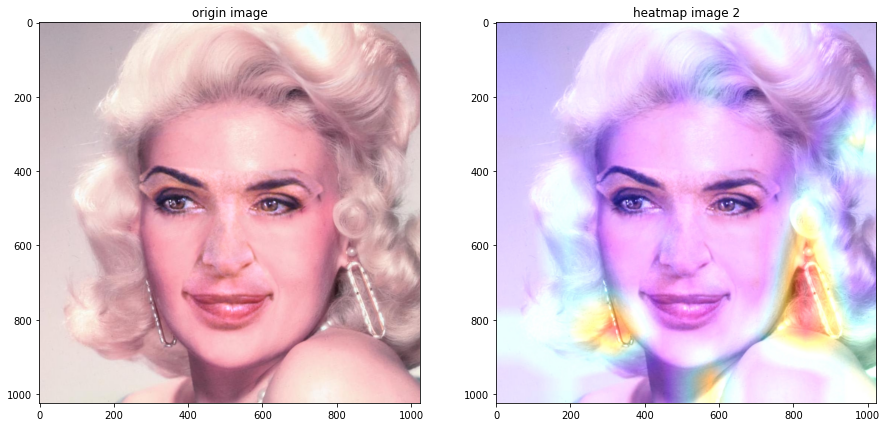

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.1383,  -4.7705]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

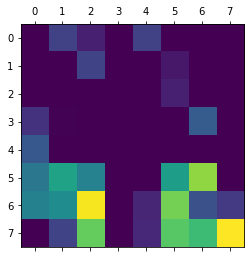

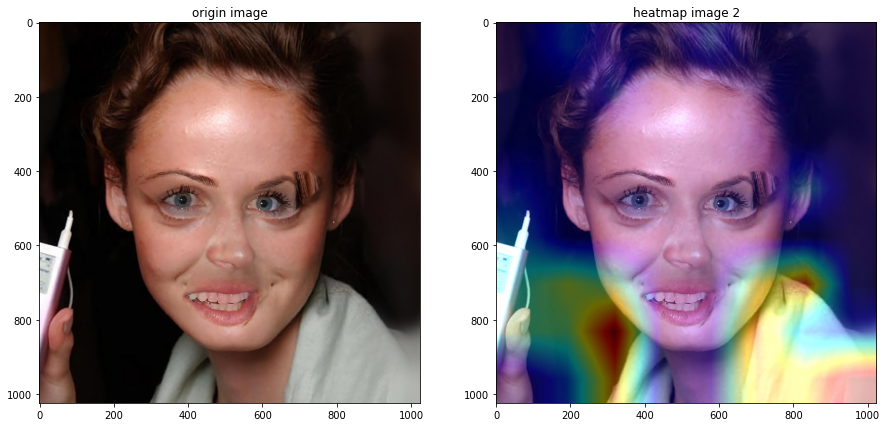

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-20.7264,  -6.0827]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

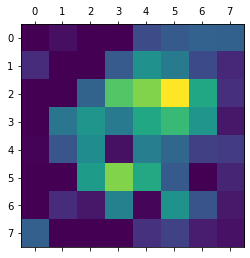

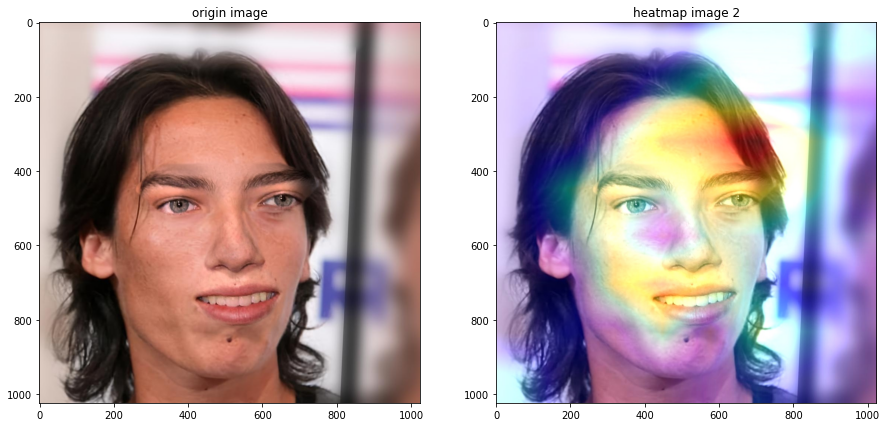

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.3077, -26.6663]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.8153, -25.0342]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.0731, -24.4863]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.0679, -24.3430]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.0274, -23.8882]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-26.5589,  -2.7199]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

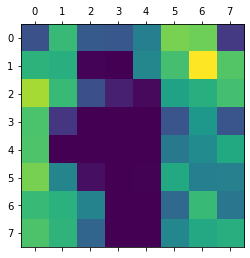

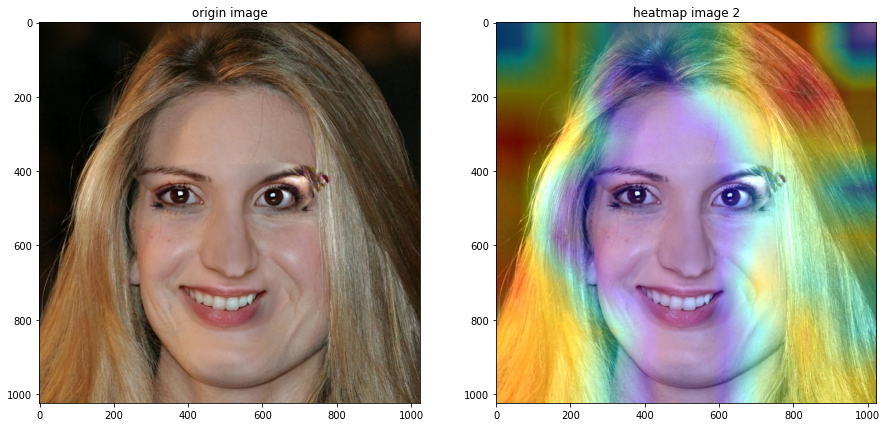

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.6450,  -4.3200]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

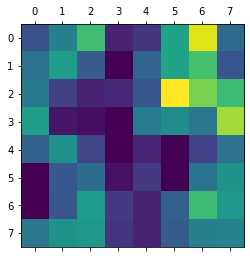

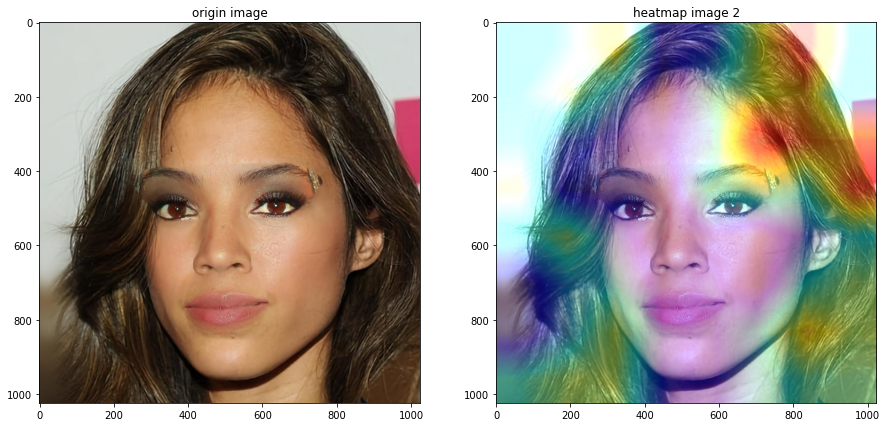

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.1488,  -4.3553]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

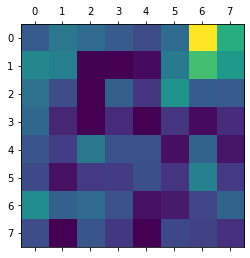

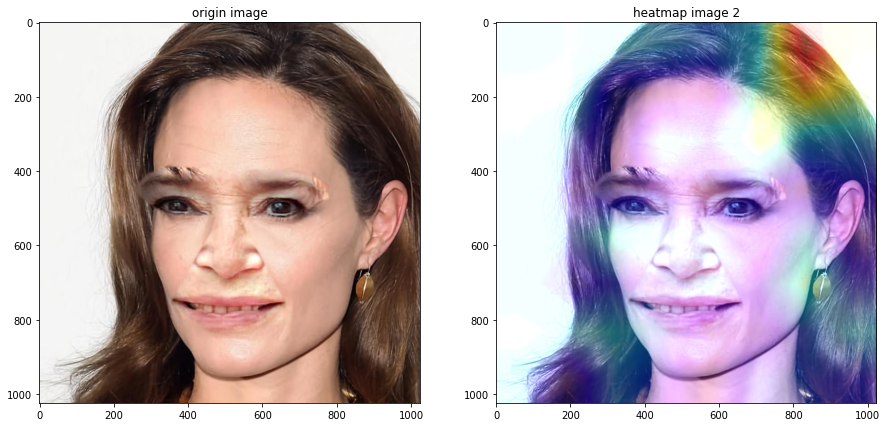

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.0501, -23.9263]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.4903, -25.8500]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.0685,  -3.5312]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

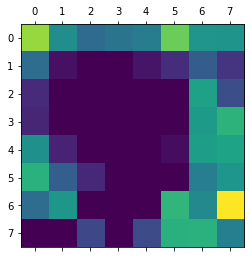

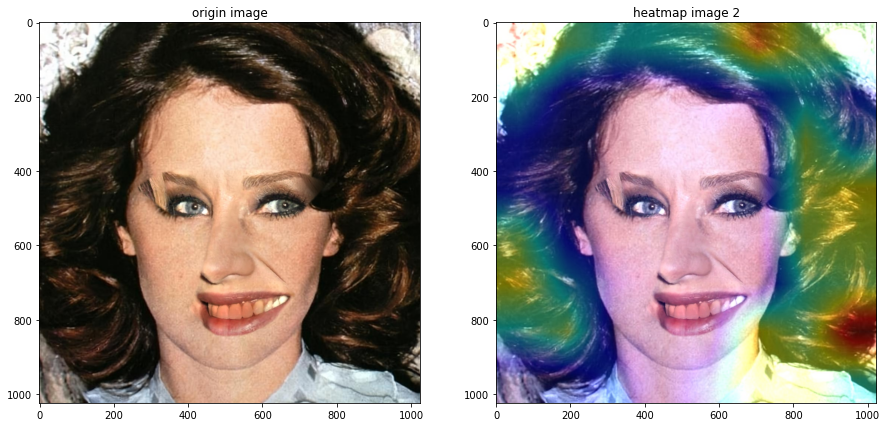

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.9574,  -3.4586]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

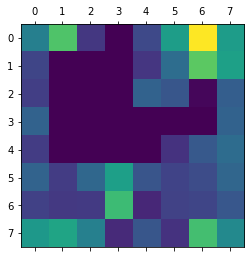

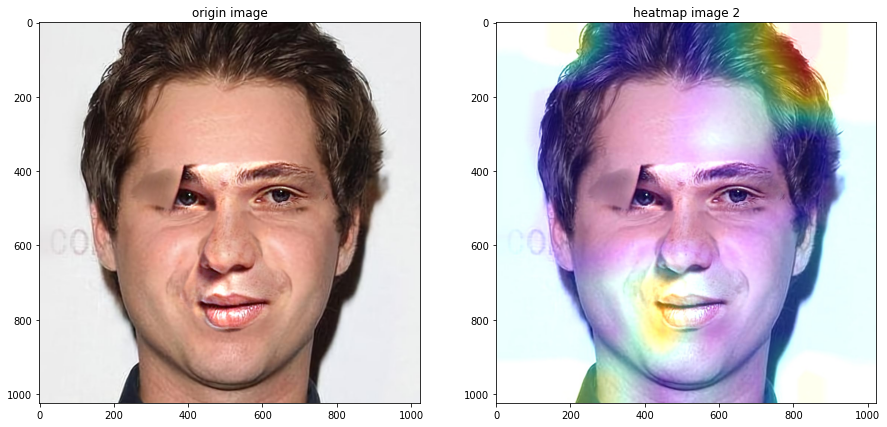

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.1422,  -4.2335]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

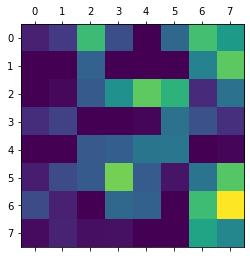

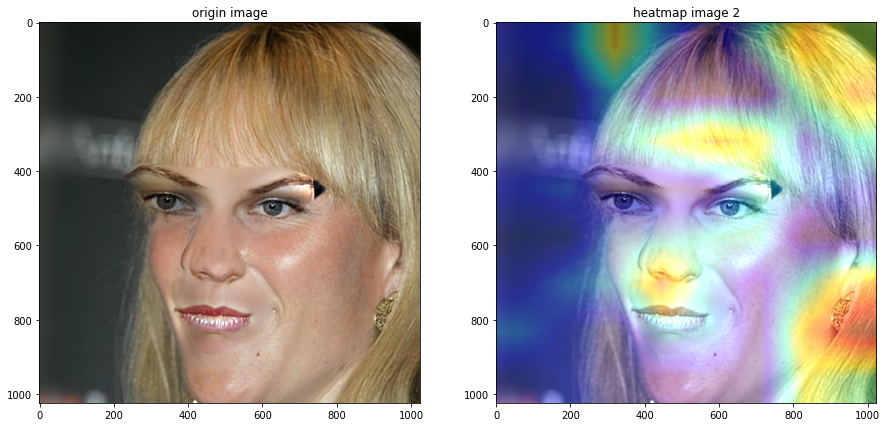

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-18.6211,  -6.3383]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

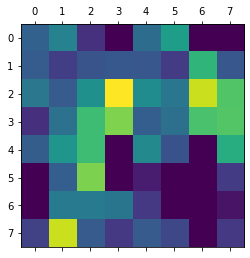

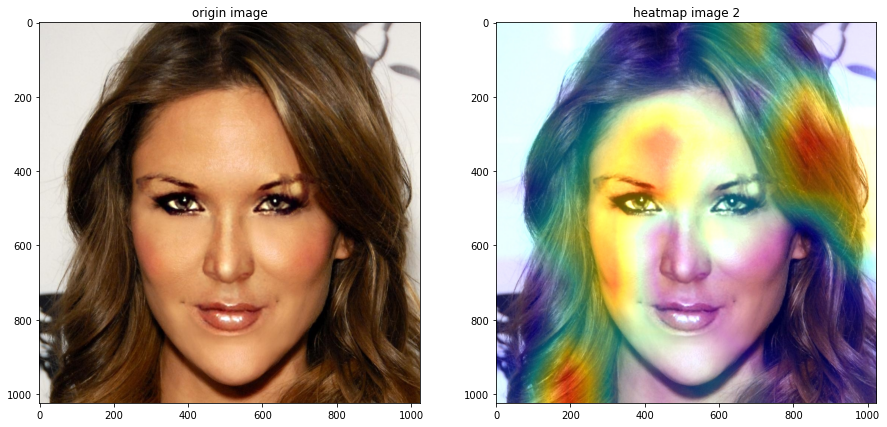

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.2133, -23.3666]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.8883,  -4.5005]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

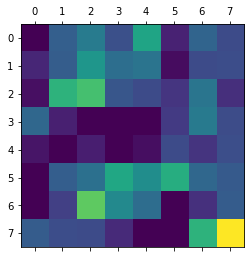

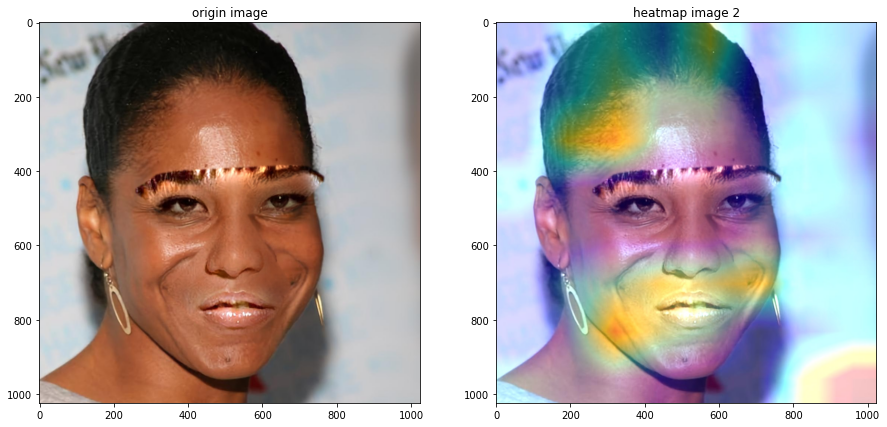

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.5187,  -4.3762]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

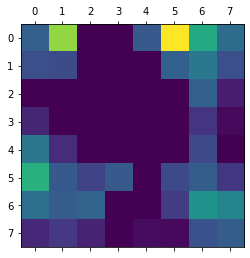

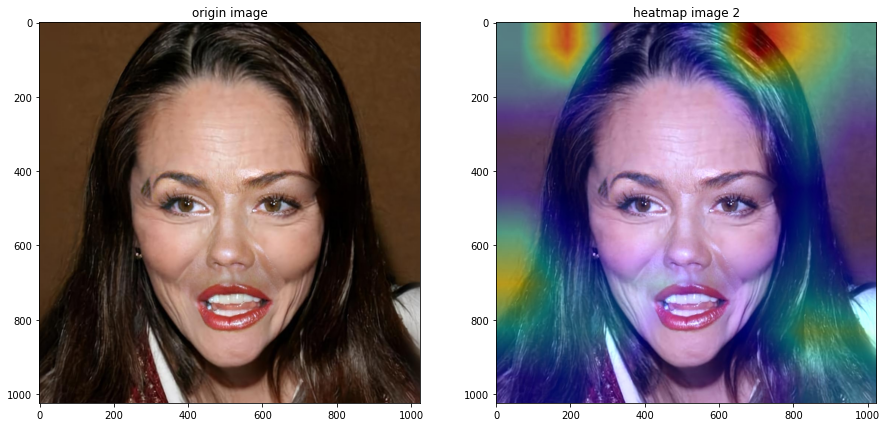

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.8091, -25.0460]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.3701, -25.0604]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.2090, -22.5851]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.6431,  -4.6313]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

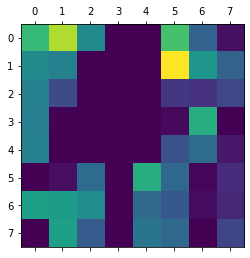

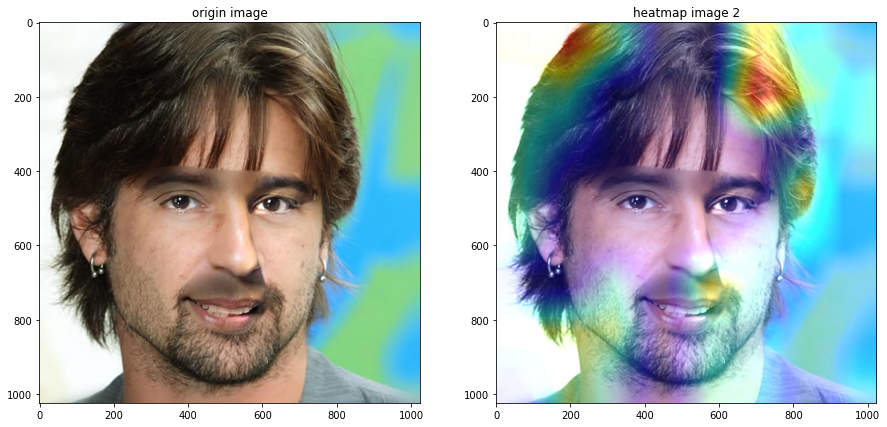

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.6436,  -6.0904]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

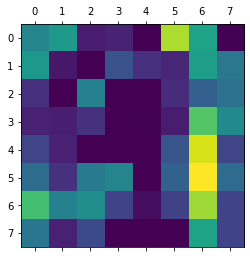

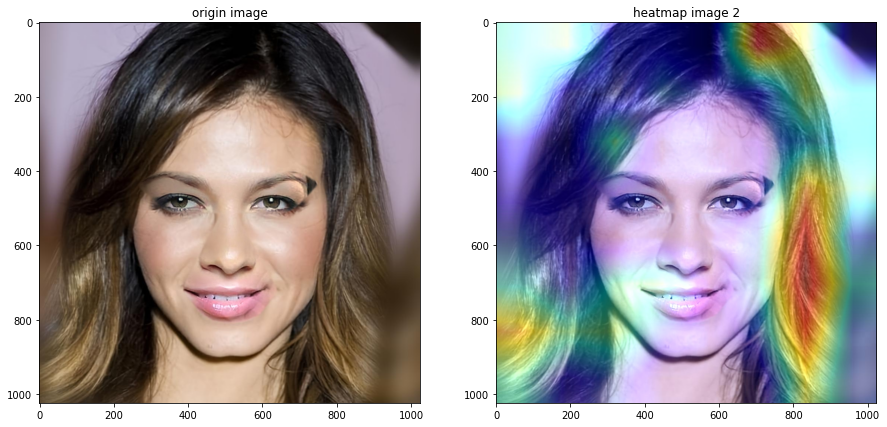

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-24.7248,  -3.8025]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

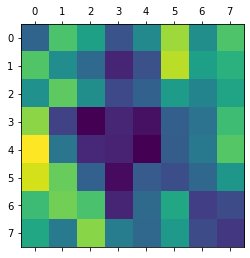

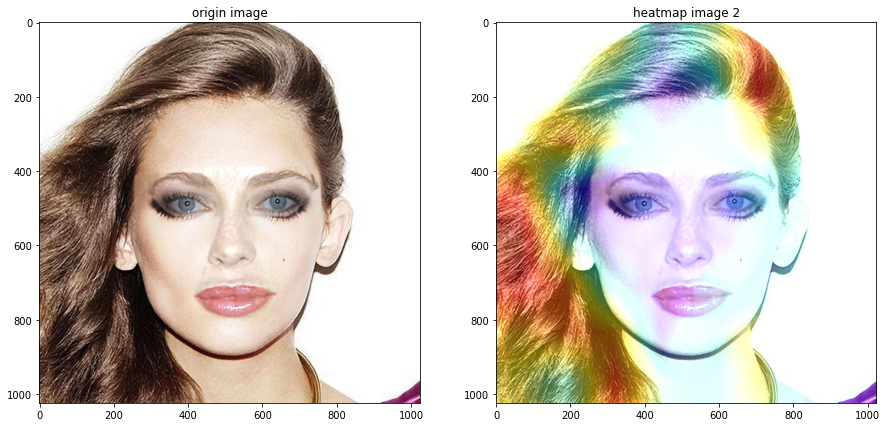

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.2562, -21.4130]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.7916, -23.9778]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.9145,  -3.7203]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

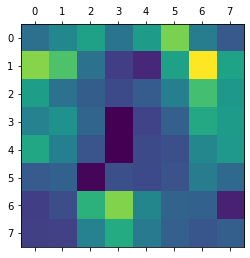

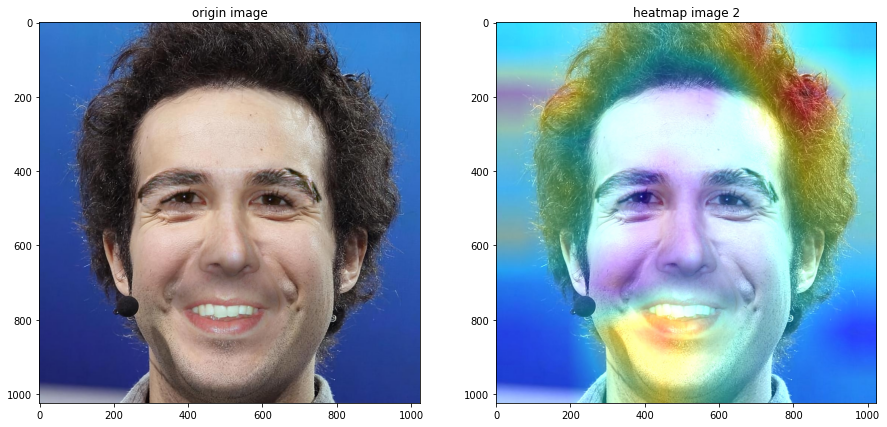

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  2.9213, -27.7771]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.1808, -23.8183]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.0156,  -4.0841]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

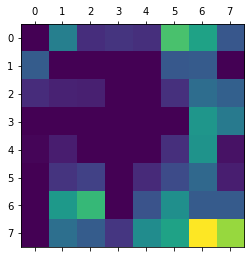

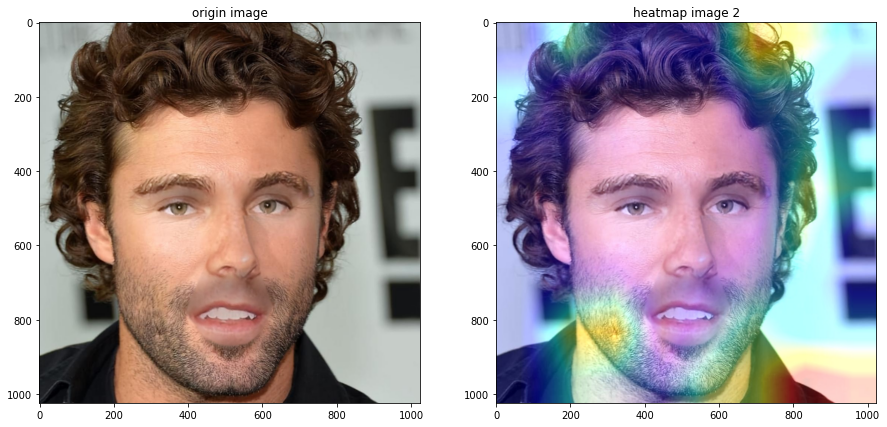

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.9874, -24.4892]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.0532, -24.1035]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.0643, -26.1190]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.0644, -26.4006]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.8671,  -4.6902]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

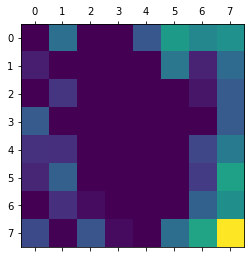

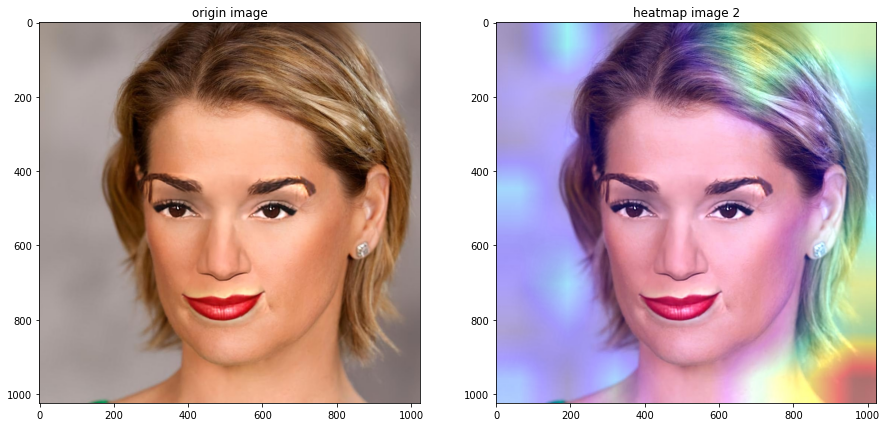

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.2944,  -5.6167]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

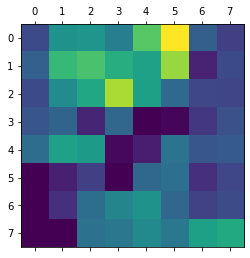

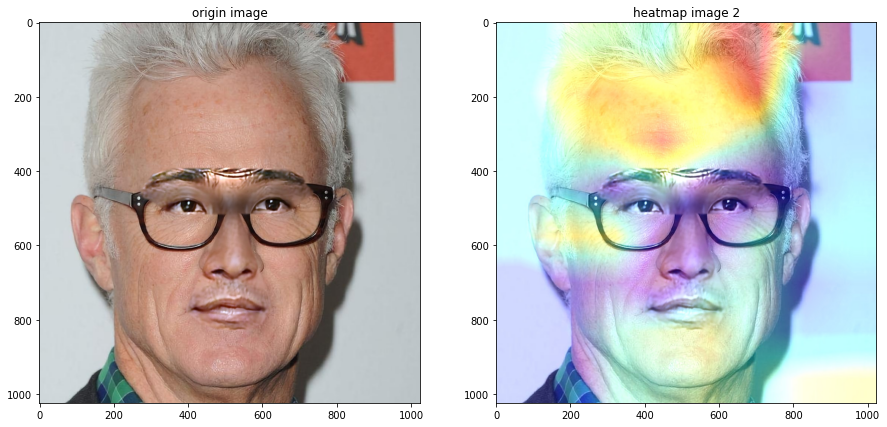

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -1.0665, -21.5308]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.4269,  -5.1587]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

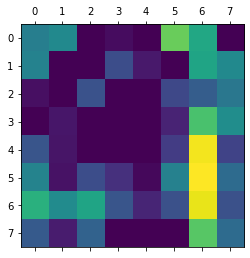

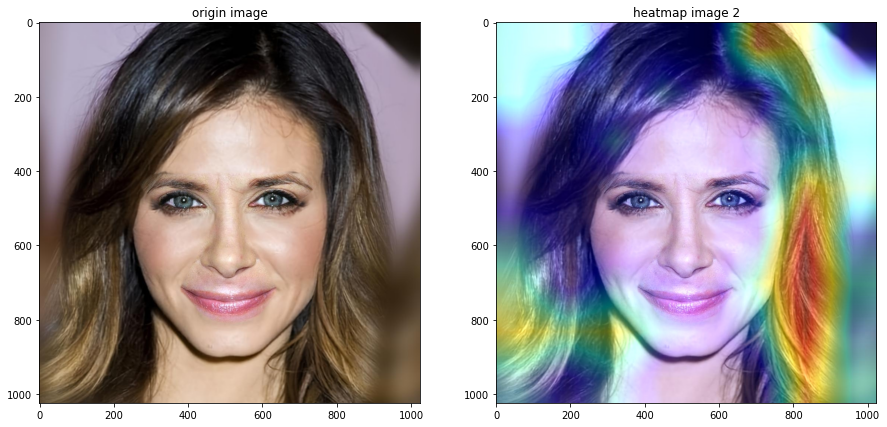

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  2.8059, -25.2063]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.4119,  -3.6801]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

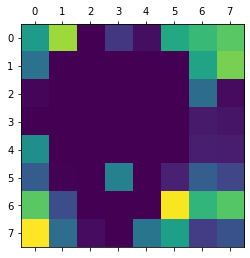

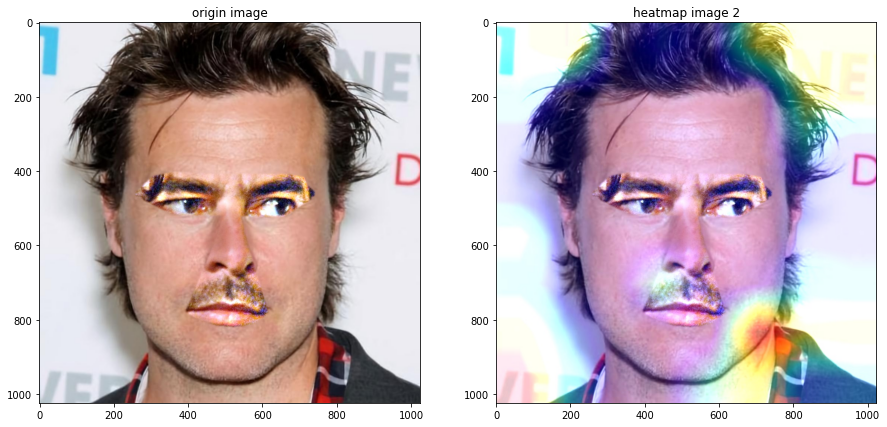

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.2929, -24.4269]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.0299, -24.0198]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-21.8768,  -5.5852]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

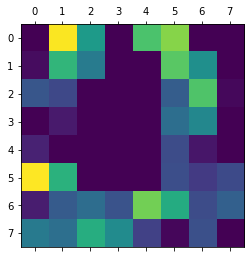

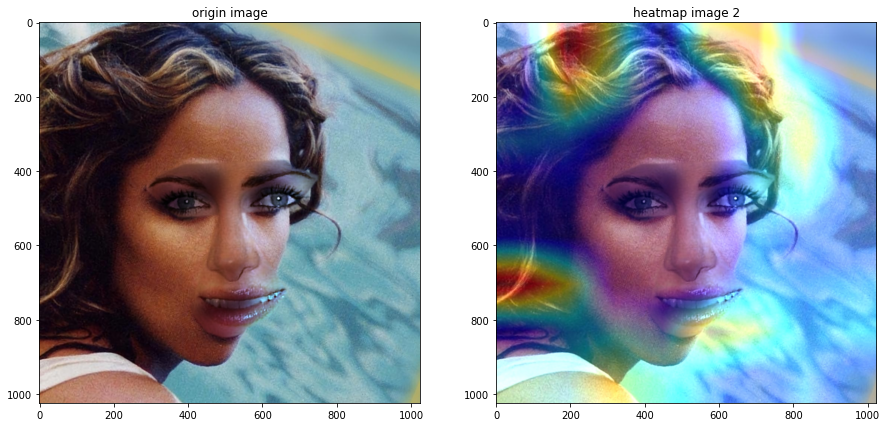

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.4158, -27.9072]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-13.8693,  -7.4293]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

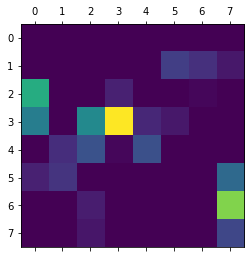

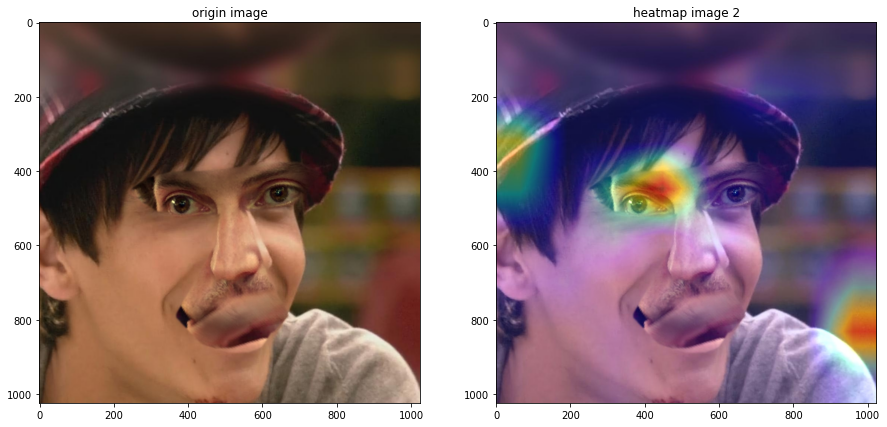

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.2044, -22.3996]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.2132, -25.1079]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.1545,  -4.4259]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

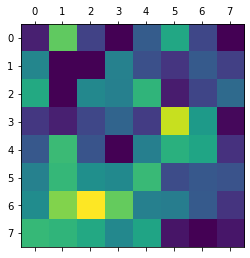

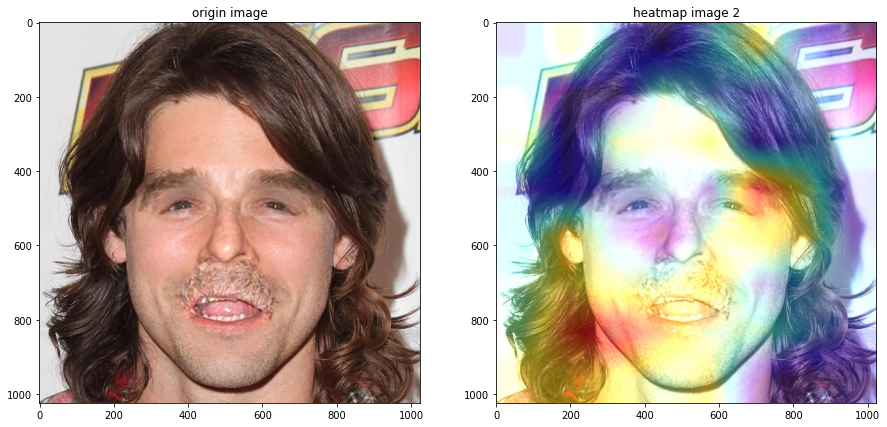

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.2289, -25.9750]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.3284,  -3.8403]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

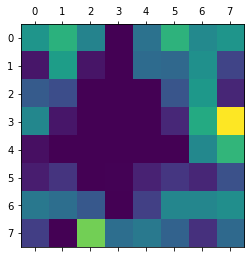

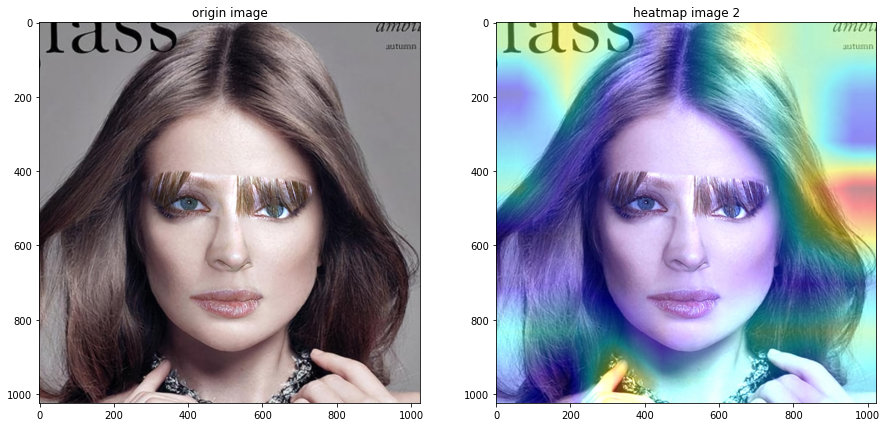

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.5857, -25.3587]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.3209, -27.0002]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-24.9656,  -3.6994]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

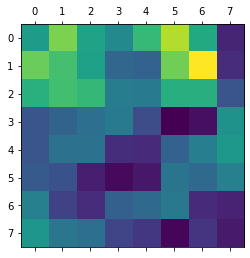

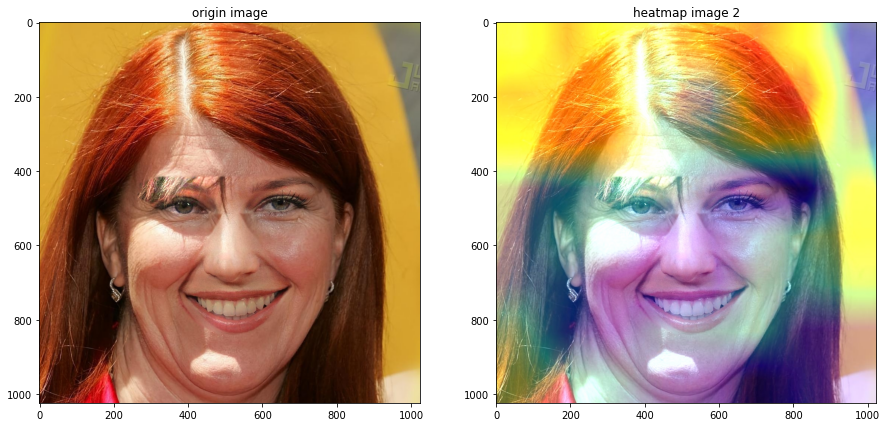

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-24.3704,  -5.0053]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

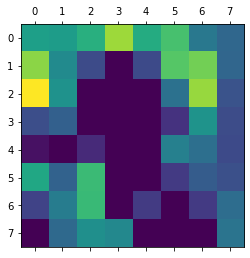

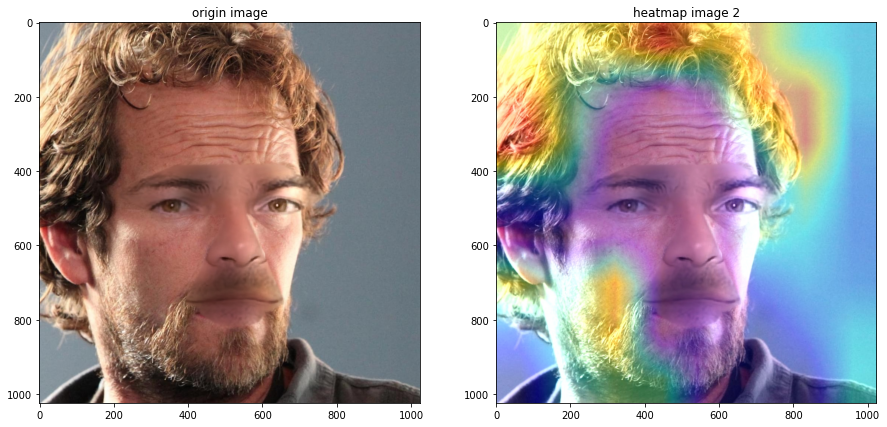

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  1.1009, -25.7864]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.2199, -24.4905]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.7904,  -3.6916]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

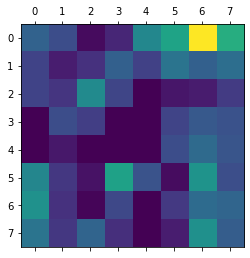

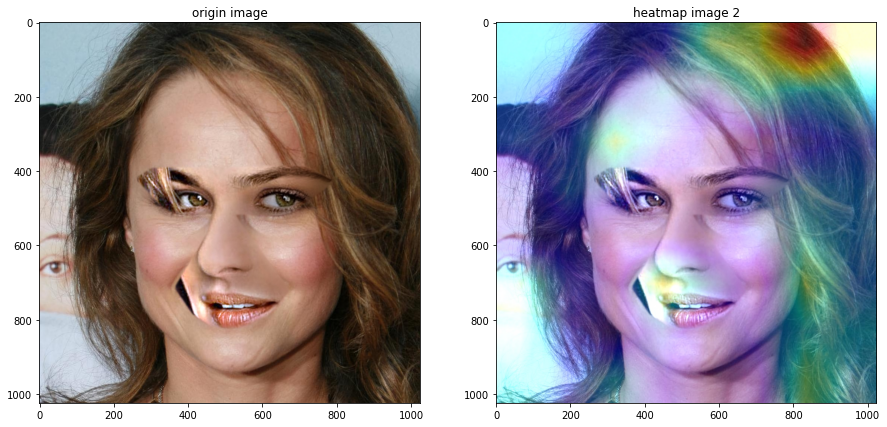

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.6173, -25.4523]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.6510,  -4.4526]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

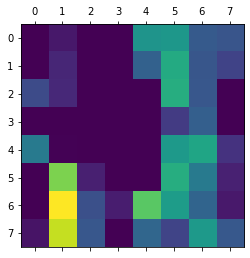

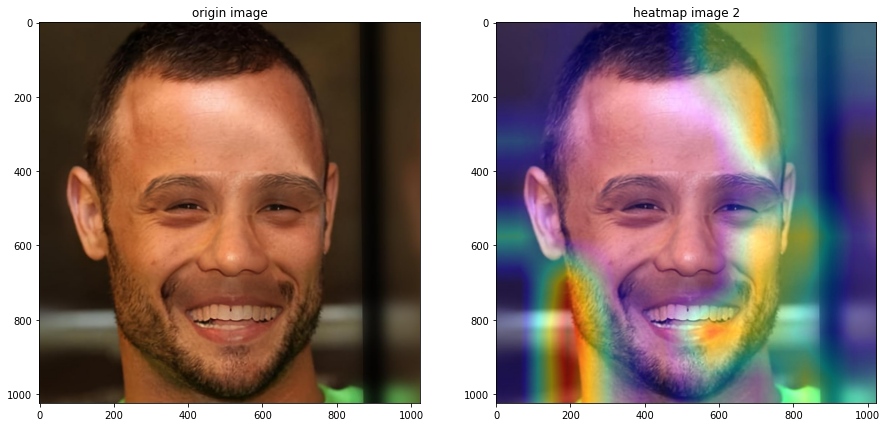

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-25.4487,  -3.1737]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

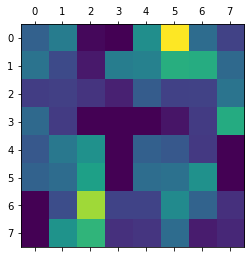

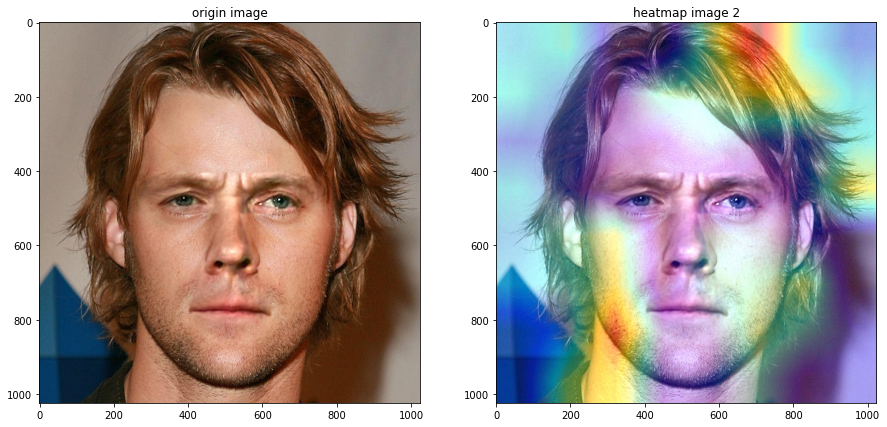

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.4248, -25.0850]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.7601, -25.2542]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-20.4463,  -4.5733]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

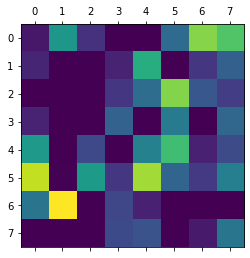

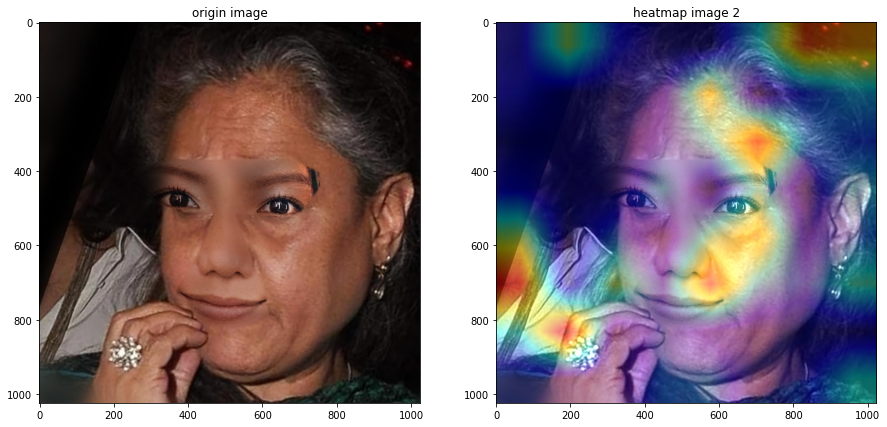

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -0.2016, -25.4710]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.9836,  -4.7484]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

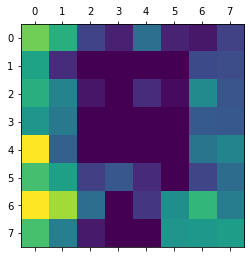

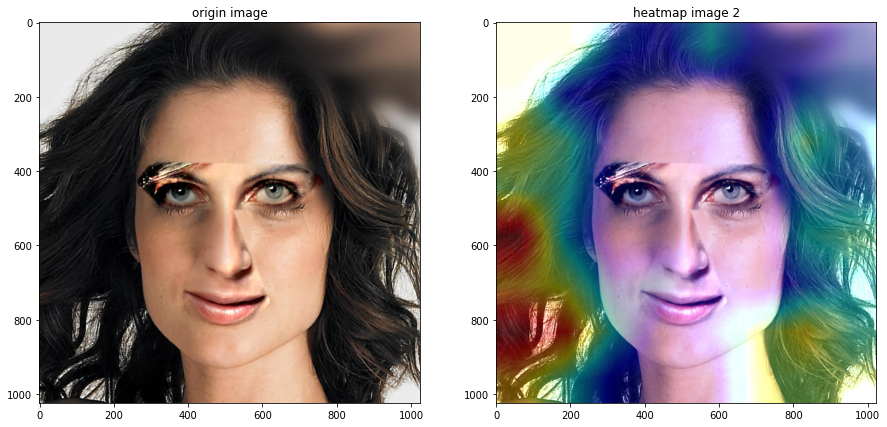

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.6328, -24.3983]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-23.8249,  -4.5846]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

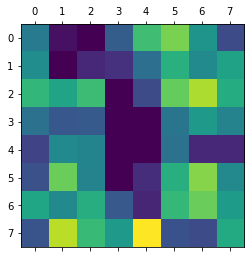

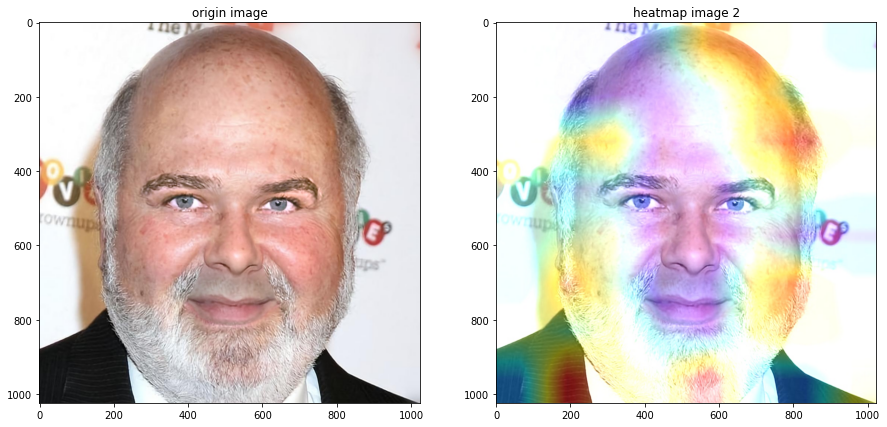

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[  0.8076, -25.4886]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-24.1172,  -3.7723]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

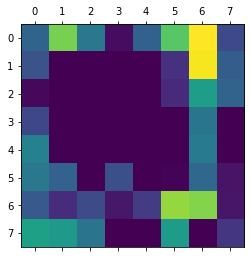

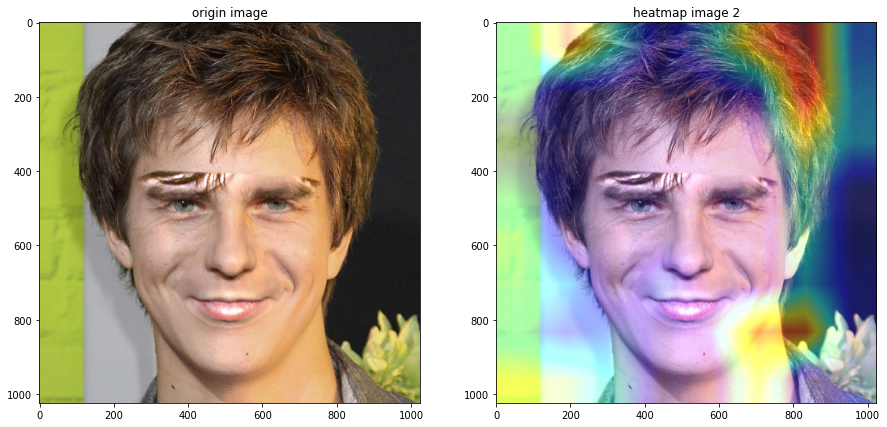

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.7445,  -6.3534]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

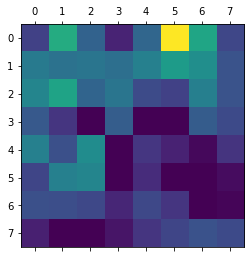

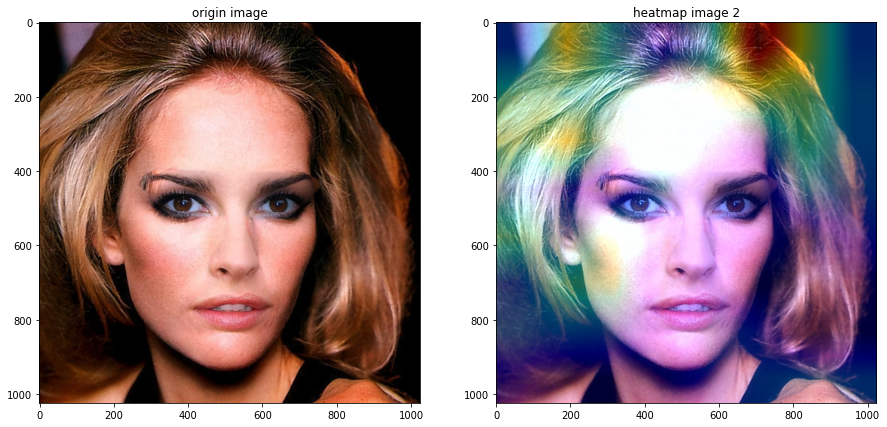

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-20.2090,  -3.0984]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
activations torch.Size([1, 112, 8, 8])


<Figure size 1440x1440 with 0 Axes>

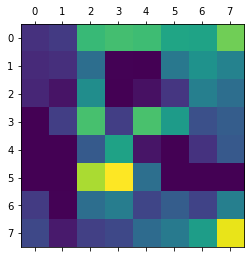

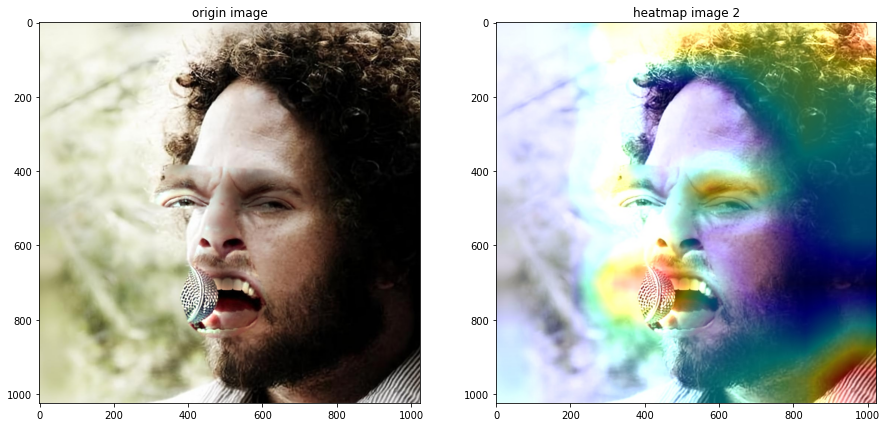

torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[ -3.4070, -14.4555]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])
torch.Size([1, 3, 128, 128]) torch.Size([1, 1, 128, 128])
tensor([[-22.8317,  -4.5245]], device='cuda:0', grad_fn=<AddmmBackward>)
torch.Size([1, 2])


In [4]:
test_dir = "/mnt/disk1/doan/phucnp/Dataset/my_extend_data/extend_data_train/{}/test".format(technique)
print("Test dir: ", test_dir)
test_loader = generate_test_dataloader_dual_cnn_stream_for_kfold_pairwise(test_dir, 128, 1, 4)
cnt = 0
model.eval()
import cv2
img_path = None
for rgb0, freq0, label0, rgb1, freq1, label1, cons_label, img0_paths in test_loader:
    rgb0, freq0 = rgb0.float().to(device), freq0.float().to(device)
    rgb1, freq1 = rgb1.float().to(device), freq1.float().to(device)
    print(rgb0.shape, freq0.shape)

    emb0, pred0, emb1, pred1 = model(rgb0, freq0, rgb1, freq1)
    print(pred0)
    print(pred0.shape)
    img_path = img0_paths[0]

    if label0[0] == 0:
        continue
    if cnt == 200:
        break
    cnt +=1
    pred0[:, 1].backward()
    # pull the gradients out of the model
    gradients = model.get_activations_gradient()
    # pool the gradients across the channels
    pooled_gradients = torch.mean(gradients, dim=[0, 2, 3])
    # get the activations of the last convolutional layer
    activations = model.get_activations(rgb0, freq0).detach()
    # weight the channels by corresponding gradients
    print('activations', activations.shape)
    for i in range(activations.shape[1]):
        activations[:, i, :, :] *= pooled_gradients[i]
    # average the channels of the activations
    heatmap = torch.mean(activations, dim=1).squeeze()
    # print('heatmap: ', heatmap)
    # relu on top of the heatmap
    # expression (2) in https://arxiv.org/pdf/1610.02391.pdf
    heatmap = torch.maximum(heatmap, torch.tensor(0.))
    # normalize the heatmap
    heatmap /= torch.max(heatmap)
    heatmap = heatmap.cpu().detach().numpy()
    #
    from PIL import Image
    plt.figure(figsize=(20, 20))
    # draw the heatmap
    plt.matshow(heatmap.squeeze())
#
    img = cv2.imread(img_path)

    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap * 0.4 + img
    cv2.imwrite('./map_{}.jpg'.format(0), superimposed_img)

    ori_image = Image.open(img_path)
    img = Image.open('./map_{}.jpg'.format(0))
    plt.figure(figsize=(15, 10))
    plt.subplot(1, 2, 1)
    plt.imshow(ori_image)
    plt.title('origin image')
    plt.subplot(1, 2, 2)
    plt.imshow(img)
    plt.title('heatmap image 2')
    plt.show()